Copyright (c) 2020 Ryan Cohn and Elizabeth Holm. All rights reserved. <br />
Licensed under the MIT License (see LICENSE for details) <br />
Written by Ryan Cohn

# Instance Segmentation of Powder Particles and Satellites

This example will take you through the process of training a model to segment powder particles and visualizing the model predictions.

In [3]:
## regular module imports
import cv2
import json
import matplotlib.pyplot as plt
import numpy as np
import os
from pathlib import Path
import pickle
import skimage.io
import sys

## detectron2
from detectron2 import model_zoo
from detectron2.config import get_cfg
from detectron2.data import (
    DatasetCatalog,
    MetadataCatalog,
)
from detectron2.engine import DefaultTrainer, DefaultPredictor
from detectron2.structures import BoxMode

root = '../../../'
ocean_images = root + '../../../../ocean/projects/dmr200021p/sprice/tuning/'
sys.path.append(root)

from ampis import data_utils, visualize, analyze
from ampis.applications import powder
from ampis.structures import InstanceSet
from ampis.visualize import display_iset

%matplotlib inline

# Labeling Data

The [VGG Image Annotator](http://www.robots.ox.ac.uk/~vgg/software/via/) was used to generate particle labels. The a

# Loading Data
The process for training models for powder particles and satellites is identical. Enter the corresponding value depending on which model you want to train. <br />
The paths to individual images, and all annotation data are stored in the JSON files generated by the VGG image annotator.



In [5]:
EXPERIMENT_NAME = 'satellite' # can be 'particle' or 'satellite'
json_path_train = Path('batch_jobs', 'SALAS_Rep', 'satellite_training.json')  # path to training data
json_path_val = Path('batch_jobs', 'SALAS_Rep', 'satellite_validation.json')  # path to training data
assert json_path_train.is_file(), 'training file not found!'
assert json_path_val.is_file(), 'validation file not found!'


## Registration
Detectron2 requires that datasets be registered for later use.
Registration stores the name of the dataset and a function that can be used to retrieve the image paths and labels in a format that the model can use.

In [6]:
DatasetCatalog.clear()  # resets catalog, helps prevent errors from running cells multiple times

# store names of datasets that will be registered for easier access later
dataset_train = f'{EXPERIMENT_NAME}_Train'
dataset_valid = f'{EXPERIMENT_NAME}_Val'

# register the training dataset
DatasetCatalog.register(dataset_train, lambda f = json_path_train: data_utils.get_ddicts(label_fmt='via2',  # annotations generated from vgg image annotator
                                                                                                     im_root=f,  # path to the training data json file
                                                                                                     dataset_class='Train'))  # indicates this is training data
# register the validation dataset
DatasetCatalog.register(dataset_valid, lambda f = json_path_val: data_utils.get_ddicts(label_fmt='via2',  # annotations generated from vgg image annotator
                                                                                                im_root=f,  # path to validation data json file
                                                                                                dataset_class='Validation'))  # indicates this is validation data
                              
print(f'Registered Datasets: {DatasetCatalog.list()}')

## There is also a metadata catalog, which stores the class names.
for d in [dataset_train, dataset_valid]:
    MetadataCatalog.get(d).set(**{'thing_classes': [EXPERIMENT_NAME]})

Registered Datasets: ['satellite_Train', 'satellite_Val']


## Verify images and annotations are loaded correctly
Also, this is a great time to admire my hand-drawn labels, which took sooooo long to do!
### Training Data

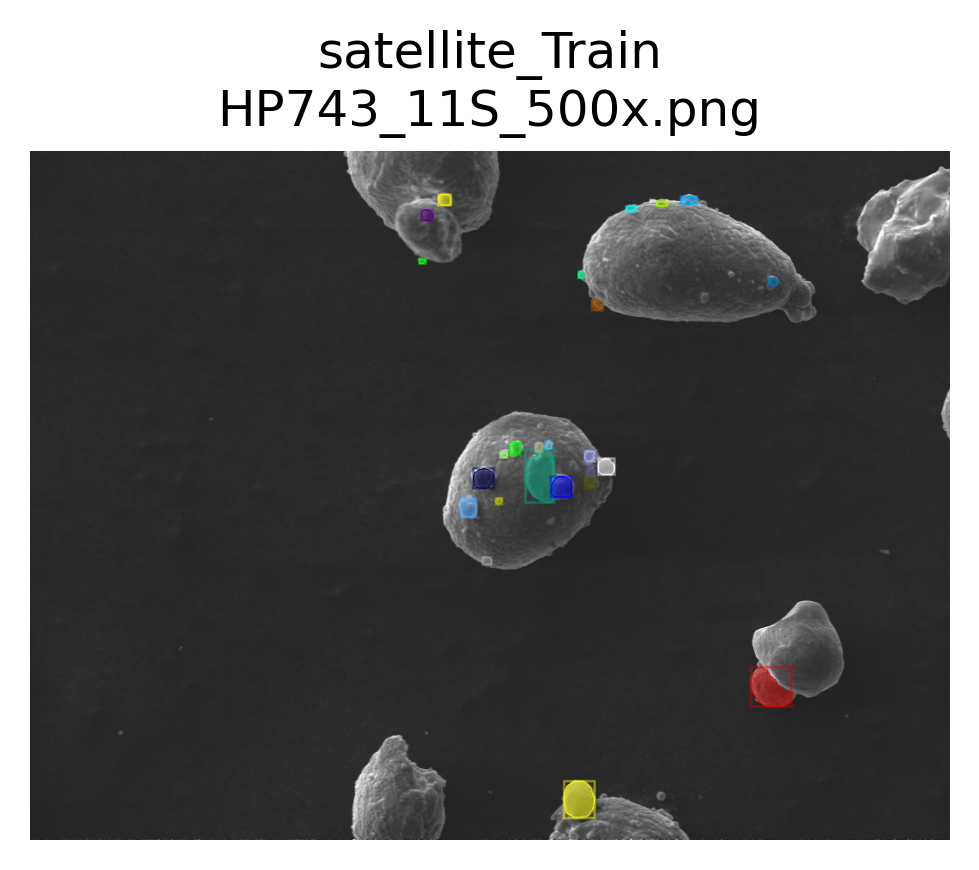

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_11S_500x.png
	num_instances: 25


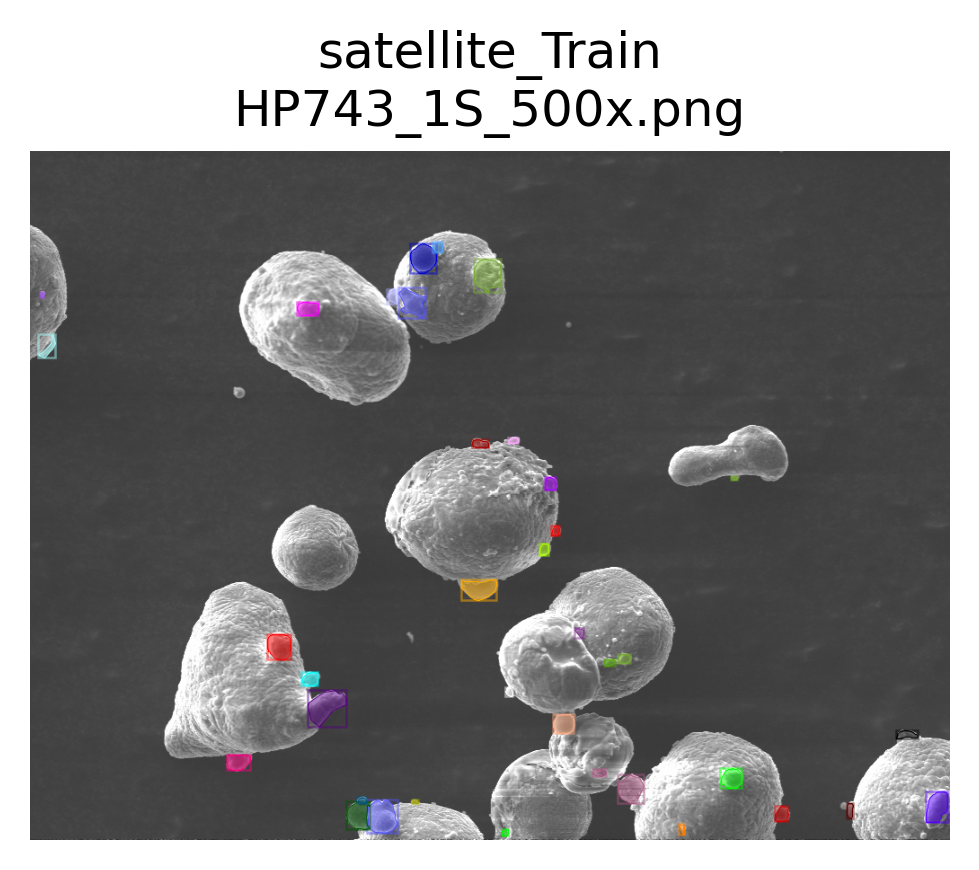

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_1S_500x.png
	num_instances: 37


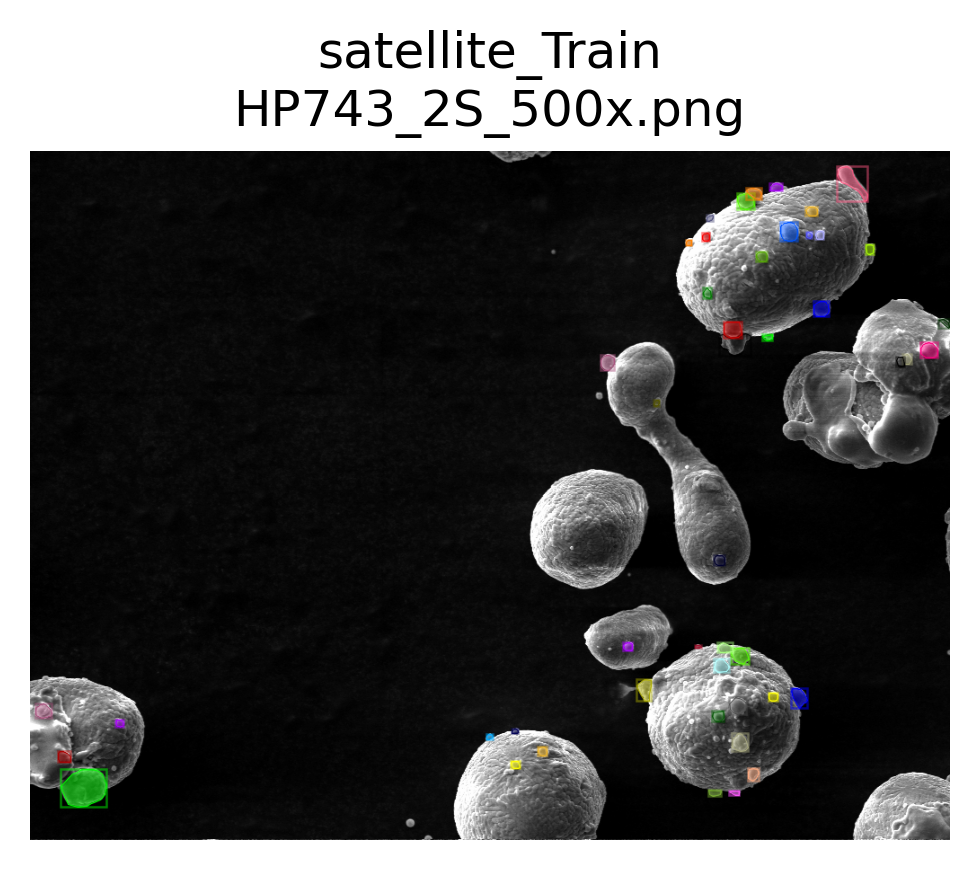

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_2S_500x.png
	num_instances: 47


In [7]:
for i in np.random.choice(DatasetCatalog.get(dataset_train), 3, replace=False):
    visualize.display_ddicts(i, None, dataset_train, suppress_labels=True)
#To view annotations on the entire dataset and not just 3 random instances, uncomment the following code
#for i in DatasetCatalog.get(dataset_train):
    #visualize.display_ddicts(i, None, dataset_train, suppress_labels=True)

### Validation Data

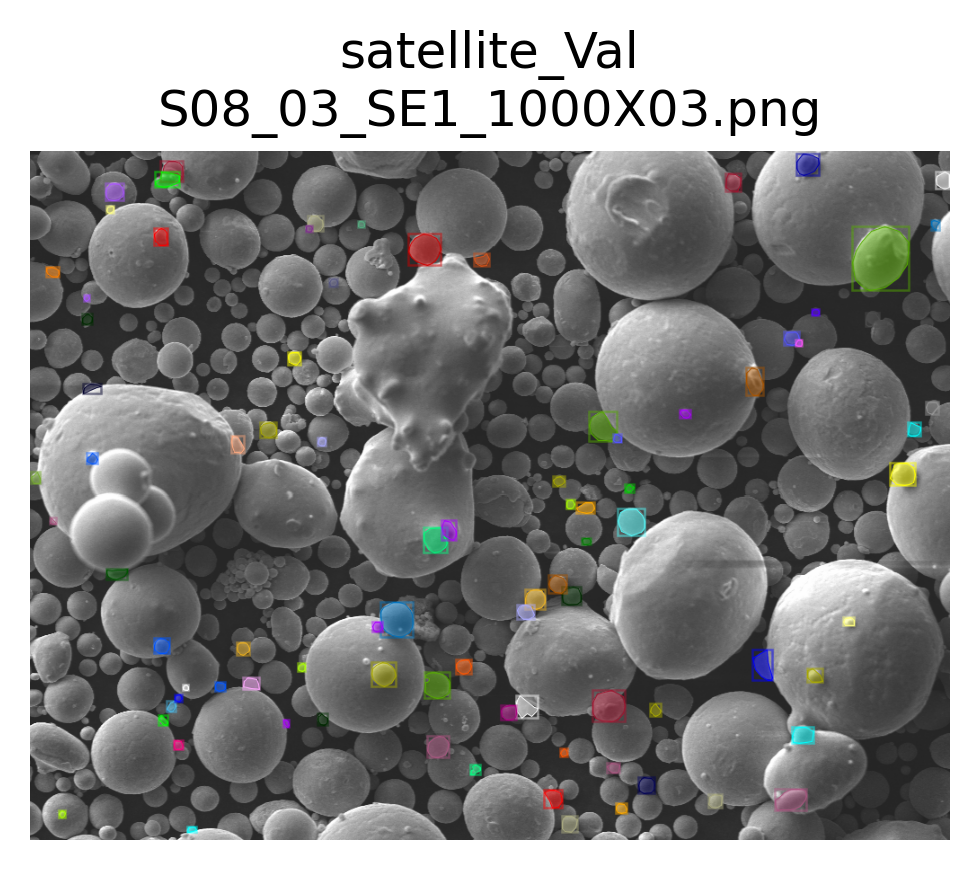

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S08_03_SE1_1000X03.png
	num_instances: 88


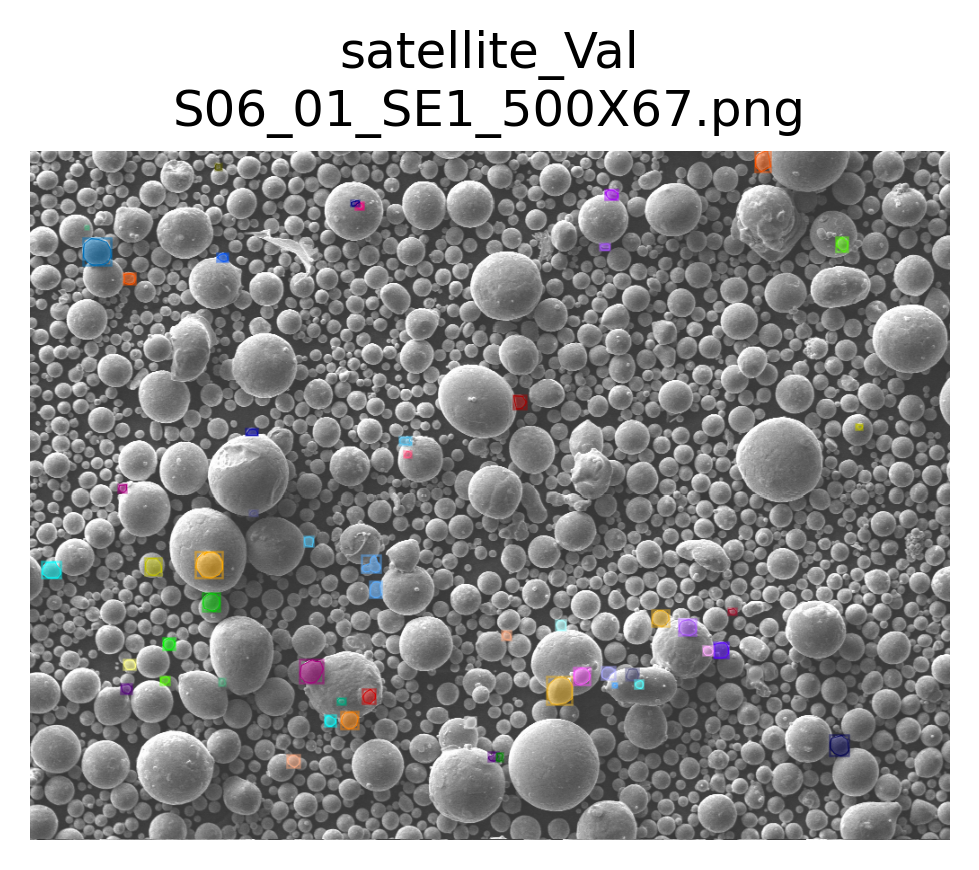

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S06_01_SE1_500X67.png
	num_instances: 54


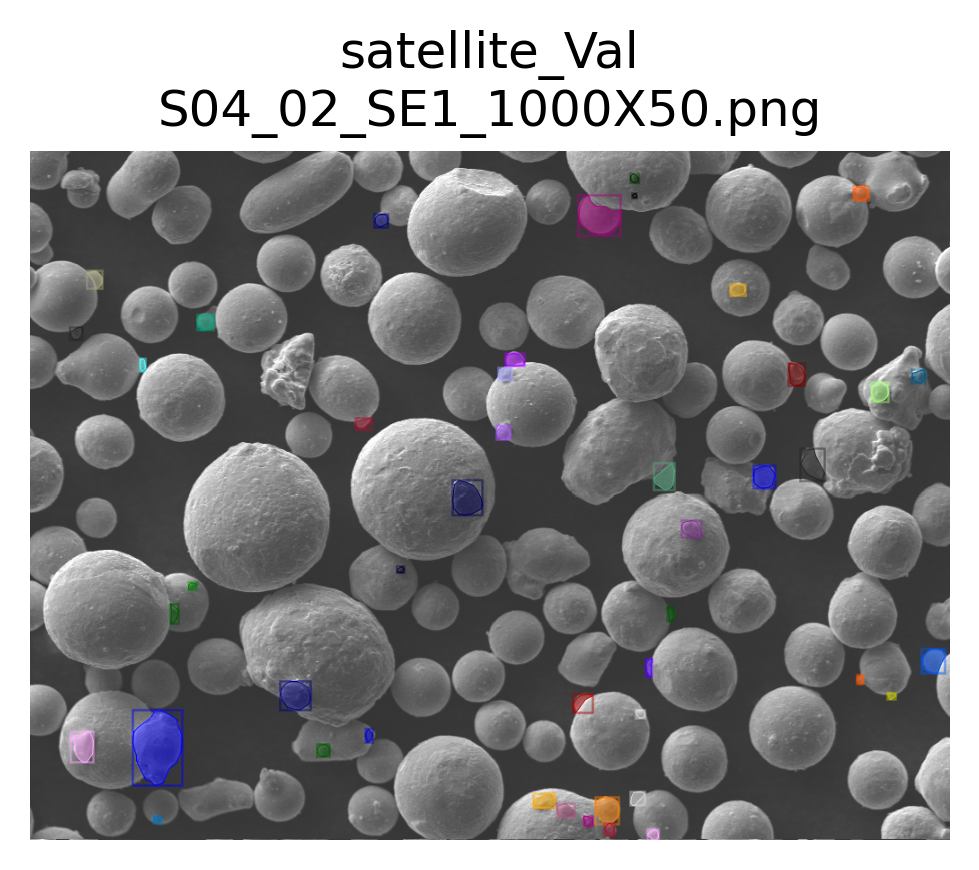

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S04_02_SE1_1000X50.png
	num_instances: 45


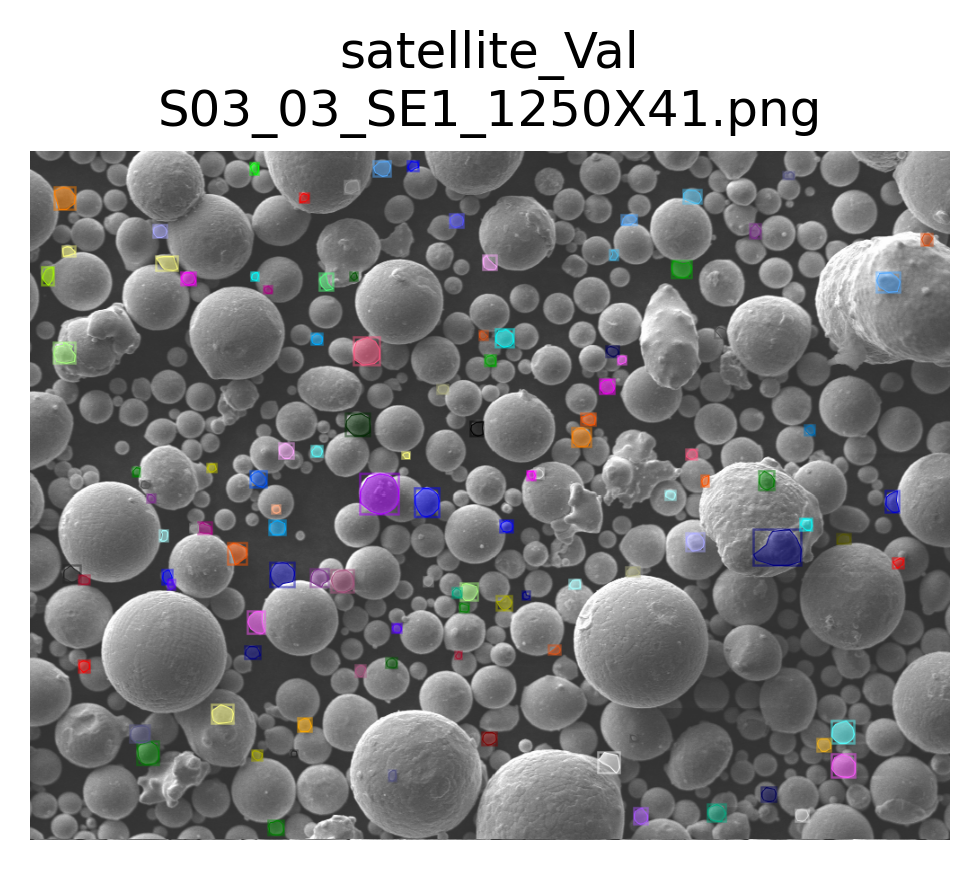

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S03_03_SE1_1250X41.png
	num_instances: 111


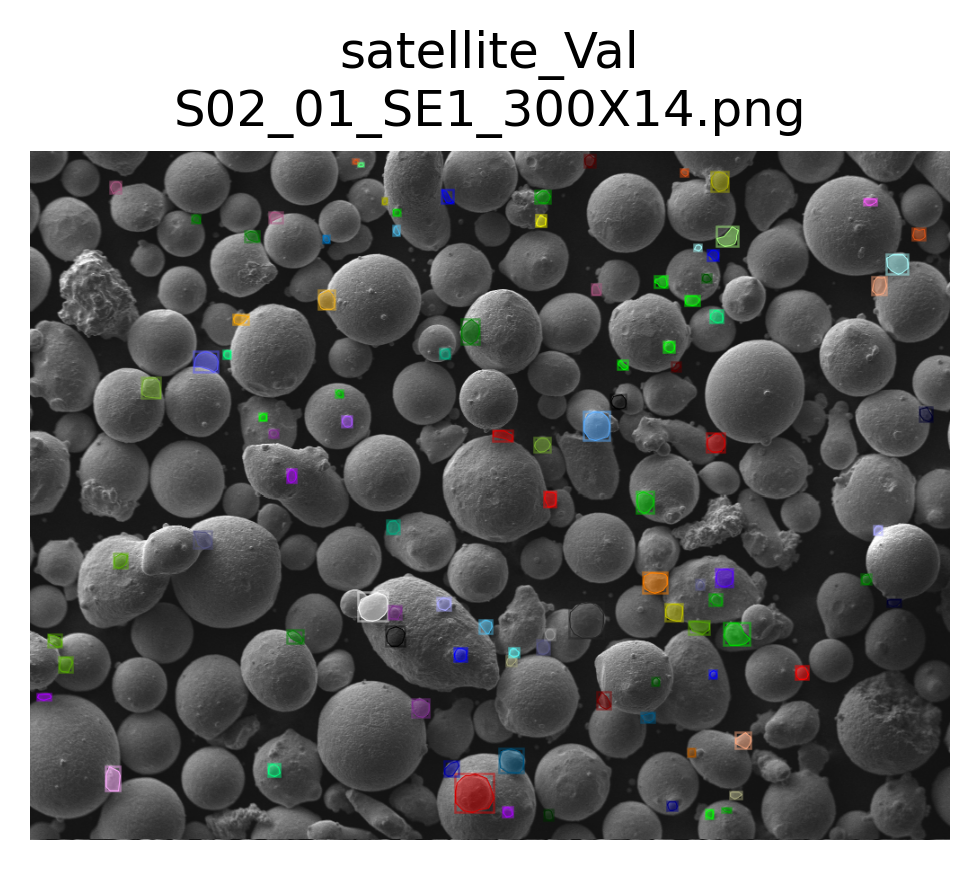

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S02_01_SE1_300X14.png
	num_instances: 98


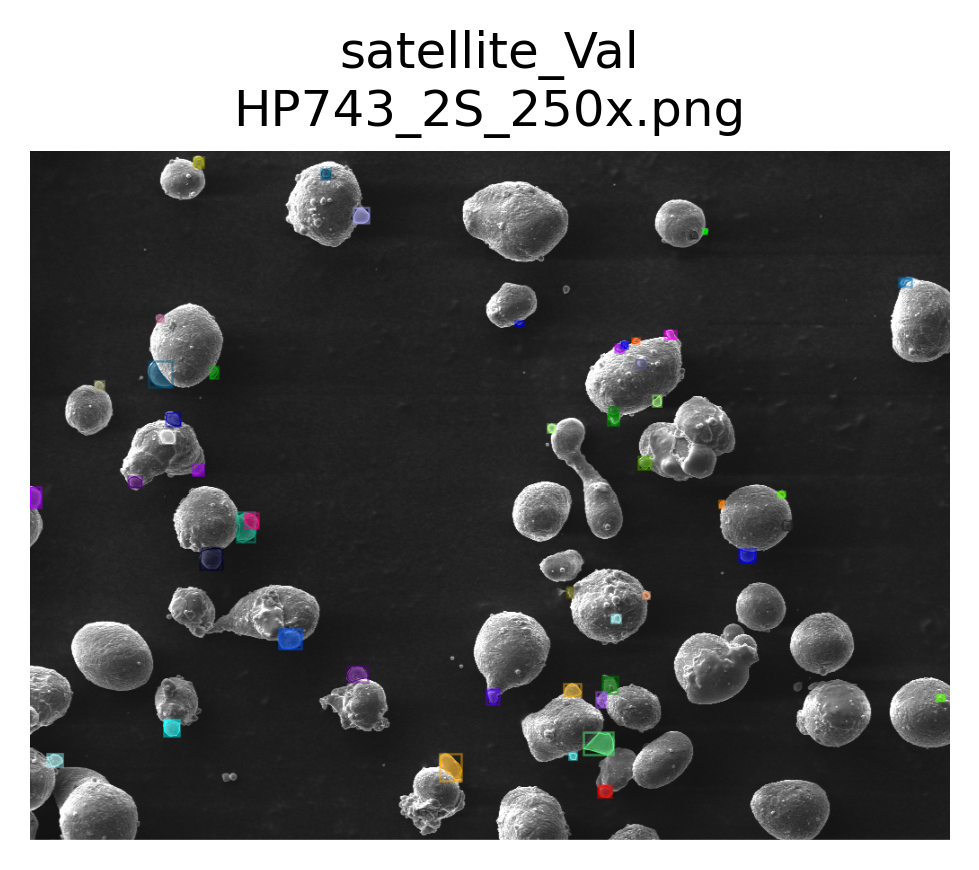

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_2S_250x.png
	num_instances: 49


In [8]:
for i in DatasetCatalog.get(dataset_valid):
    visualize.display_ddicts(i, None, dataset_valid, suppress_labels=True)

## Model Configuration
This is where we specify the directory where the outputs are saved, various hyperparameters for the model, and more.

In [12]:
cfg = get_cfg() # initialize cfg object
cfg.merge_from_file(model_zoo.get_config_file('COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml'))  # load default parameters for Mask R-CNN
cfg.INPUT.MASK_FORMAT = 'polygon'  # masks generated in VGG image annotator are polygons
cfg.DATASETS.TRAIN = (dataset_train,)  # dataset used for training model
cfg.DATASETS.TEST = (dataset_train, dataset_valid)  # we will look at the predictions on both sets after training
cfg.SOLVER.IMS_PER_BATCH = 1 # number of images per batch (across all machines)
cfg.SOLVER.CHECKPOINT_PERIOD = 1000  # number of iterations after which to save model checkpoints
cfg.MODEL.DEVICE='cuda'  # 'cpu' to force model to run on cpu, 'cuda' if you have a compatible gpu
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 1 # Since we are training separate models for particles and satellites there is only one class output
cfg.TEST.DETECTIONS_PER_IMAGE = 400 if EXPERIMENT_NAME == 'particle' else 250  # maximum number of instances that can be detected in an image (this is fixed in mask r-cnn)
cfg.SOLVER.MAX_ITER = 5000  # maximum number of iterations to run during training
                            # Increasing this may improve the training results, but will take longer to run (especially without a gpu!)
cfg.MODEL.RETINANET.SCORE_THRESH_TEST = 0.5
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5
cfg.MODEL.PANOPTIC_FPN.COMBINE.INSTANCES_CONFIDENCE_THRESH = 0.5
# model weights will be downloaded if they are not present
weights_path = Path('..','models','model_final_f10217.pkl')
if weights_path.is_file():
    print('Using locally stored weights: {}'.format(weights_path))
else:
    weights_path = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")
    print('Weights not found, weights will be downloaded from source: {}'.format(weights_path))
cfg.MODEL.WEIGHTs = str(weights_path)
cfg.OUTPUT_DIR = str(Path('DEMO_TEST'))
# make the output directory
os.makedirs(Path(cfg.OUTPUT_DIR), exist_ok=True)

Weights not found, weights will be downloaded from source: https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl


# Model Training
Once we have everything set up, training is very easy!

Note- this block will generate a huge wall of text.

In [13]:
trainer = DefaultTrainer(cfg)  # create trainer object from cfg
trainer.resume_or_load(resume=False)  # start training from iteration 0
trainer.train()  # train the model!

[09/15 23:26:55 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

[09/15 23:26:55 d2.data.build]: Removed 0 images with no usable annotations. 20 images left.
[09/15 23:26:55 d2.data.build]: Distribution of instances among all 1 categories:
|  category  | #instances   |
|:----------:|:-------------|
| satellite  | 1412         |
|            |              |
[09/15 23:26:55 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in training: [ResizeShortestEdge(short_edge_length=(640, 672, 704, 736, 768, 800), max_size=1333, sample_style='choice'), RandomFlip()]
[09/15 23:26:55 d2.data.build]: Using training sampler TrainingSampler
[09/15 23:26:55 d2.data.common]: Serializing 20 elements to byte tensors and concatenating them all ...
[09/15 23:26:55 d2.data.common]: Serialized dataset takes 0.46 MiB
WARNING [09/15 23:26:55 d2.solver.build]: SOLVER.STEPS contains values larger than SOLVER.MAX_ITER. These values will be ignored.


/jet/home/sprice/.local/lib/python3.8/site-packages/torch/utils/data/dataloader.py:474: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 1, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(


[09/15 23:26:55 d2.checkpoint.c2_model_loading]: Renaming Caffe2 weights ......
[09/15 23:26:56 d2.checkpoint.c2_model_loading]: Following weights matched with submodule backbone.bottom_up:
| Names in Model    | Names in Checkpoint      | Shapes                                          |
|:------------------|:-------------------------|:------------------------------------------------|
| res2.0.conv1.*    | res2_0_branch2a_{bn_*,w} | (64,) (64,) (64,) (64,) (64,64,1,1)             |
| res2.0.conv2.*    | res2_0_branch2b_{bn_*,w} | (64,) (64,) (64,) (64,) (64,64,3,3)             |
| res2.0.conv3.*    | res2_0_branch2c_{bn_*,w} | (256,) (256,) (256,) (256,) (256,64,1,1)        |
| res2.0.shortcut.* | res2_0_branch1_{bn_*,w}  | (256,) (256,) (256,) (256,) (256,64,1,1)        |
| res2.1.conv1.*    | res2_1_branch2a_{bn_*,w} | (64,) (64,) (64,) (64,) (64,256,1,1)            |
| res2.1.conv2.*    | res2_1_branch2b_{bn_*,w} | (64,) (64,) (64,) (64,) (64,64,3,3)             |
| res2.1.conv3.*  

[09/15 23:27:30 d2.utils.events]:  eta: 0:11:35  iter: 219  total_loss: 1.808  loss_cls: 0.2254  loss_box_reg: 0.4035  loss_mask: 0.3606  loss_rpn_cls: 0.3219  loss_rpn_loc: 0.4553  time: 0.1462  data_time: 0.0154  lr: 0.0043956  max_mem: 1824M
[09/15 23:27:33 d2.utils.events]:  eta: 0:11:35  iter: 239  total_loss: 1.794  loss_cls: 0.2556  loss_box_reg: 0.4361  loss_mask: 0.3385  loss_rpn_cls: 0.2126  loss_rpn_loc: 0.4616  time: 0.1467  data_time: 0.0160  lr: 0.0047952  max_mem: 1824M
[09/15 23:27:36 d2.utils.events]:  eta: 0:11:33  iter: 259  total_loss: 1.71  loss_cls: 0.2387  loss_box_reg: 0.4157  loss_mask: 0.3289  loss_rpn_cls: 0.2471  loss_rpn_loc: 0.4524  time: 0.1469  data_time: 0.0163  lr: 0.0051948  max_mem: 1824M
[09/15 23:27:39 d2.utils.events]:  eta: 0:11:31  iter: 279  total_loss: 1.688  loss_cls: 0.2441  loss_box_reg: 0.4479  loss_mask: 0.3215  loss_rpn_cls: 0.2451  loss_rpn_loc: 0.4551  time: 0.1469  data_time: 0.0154  lr: 0.0055944  max_mem: 1824M
[09/15 23:27:42 d2.ut

[09/15 23:29:10 d2.utils.events]:  eta: 0:10:14  iter: 879  total_loss: 1.484  loss_cls: 0.2127  loss_box_reg: 0.3809  loss_mask: 0.2496  loss_rpn_cls: 0.1824  loss_rpn_loc: 0.4432  time: 0.1496  data_time: 0.0165  lr: 0.017582  max_mem: 1824M
[09/15 23:29:13 d2.utils.events]:  eta: 0:10:11  iter: 899  total_loss: 1.391  loss_cls: 0.1821  loss_box_reg: 0.3436  loss_mask: 0.2235  loss_rpn_cls: 0.1564  loss_rpn_loc: 0.4217  time: 0.1496  data_time: 0.0151  lr: 0.017982  max_mem: 1824M
[09/15 23:29:16 d2.utils.events]:  eta: 0:10:08  iter: 919  total_loss: 1.455  loss_cls: 0.218  loss_box_reg: 0.4138  loss_mask: 0.2455  loss_rpn_cls: 0.1785  loss_rpn_loc: 0.4151  time: 0.1497  data_time: 0.0162  lr: 0.018382  max_mem: 1824M
[09/15 23:29:19 d2.utils.events]:  eta: 0:10:06  iter: 939  total_loss: 1.551  loss_cls: 0.2436  loss_box_reg: 0.4422  loss_mask: 0.2403  loss_rpn_cls: 0.1423  loss_rpn_loc: 0.4223  time: 0.1498  data_time: 0.0155  lr: 0.018781  max_mem: 1824M
[09/15 23:29:22 d2.utils.

[09/15 23:30:51 d2.utils.events]:  eta: 0:08:43  iter: 1539  total_loss: 1.394  loss_cls: 0.2309  loss_box_reg: 0.411  loss_mask: 0.1966  loss_rpn_cls: 0.1522  loss_rpn_loc: 0.387  time: 0.1505  data_time: 0.0165  lr: 0.02  max_mem: 1824M
[09/15 23:30:54 d2.utils.events]:  eta: 0:08:40  iter: 1559  total_loss: 1.411  loss_cls: 0.2093  loss_box_reg: 0.4135  loss_mask: 0.2037  loss_rpn_cls: 0.1735  loss_rpn_loc: 0.4118  time: 0.1506  data_time: 0.0170  lr: 0.02  max_mem: 1824M
[09/15 23:30:58 d2.utils.events]:  eta: 0:08:38  iter: 1579  total_loss: 1.383  loss_cls: 0.2301  loss_box_reg: 0.4305  loss_mask: 0.2062  loss_rpn_cls: 0.1461  loss_rpn_loc: 0.3797  time: 0.1511  data_time: 0.0302  lr: 0.02  max_mem: 1824M
[09/15 23:31:02 d2.utils.events]:  eta: 0:08:35  iter: 1599  total_loss: 1.331  loss_cls: 0.205  loss_box_reg: 0.3891  loss_mask: 0.1995  loss_rpn_cls: 0.137  loss_rpn_loc: 0.379  time: 0.1513  data_time: 0.0158  lr: 0.02  max_mem: 1824M
[09/15 23:31:05 d2.utils.events]:  eta: 0

[09/15 23:32:34 d2.utils.events]:  eta: 0:07:05  iter: 2199  total_loss: 1.236  loss_cls: 0.1925  loss_box_reg: 0.3895  loss_mask: 0.1855  loss_rpn_cls: 0.1188  loss_rpn_loc: 0.3415  time: 0.1515  data_time: 0.0158  lr: 0.02  max_mem: 1824M
[09/15 23:32:37 d2.utils.events]:  eta: 0:07:02  iter: 2219  total_loss: 1.268  loss_cls: 0.1772  loss_box_reg: 0.3548  loss_mask: 0.1943  loss_rpn_cls: 0.155  loss_rpn_loc: 0.3729  time: 0.1515  data_time: 0.0158  lr: 0.02  max_mem: 1824M
[09/15 23:32:40 d2.utils.events]:  eta: 0:06:59  iter: 2239  total_loss: 1.319  loss_cls: 0.1983  loss_box_reg: 0.3922  loss_mask: 0.1865  loss_rpn_cls: 0.1446  loss_rpn_loc: 0.3716  time: 0.1515  data_time: 0.0154  lr: 0.02  max_mem: 1824M
[09/15 23:32:43 d2.utils.events]:  eta: 0:06:56  iter: 2259  total_loss: 1.283  loss_cls: 0.1971  loss_box_reg: 0.3993  loss_mask: 0.2001  loss_rpn_cls: 0.1432  loss_rpn_loc: 0.3479  time: 0.1516  data_time: 0.0160  lr: 0.02  max_mem: 1824M
[09/15 23:32:46 d2.utils.events]:  et

[09/15 23:34:15 d2.utils.events]:  eta: 0:05:24  iter: 2859  total_loss: 1.151  loss_cls: 0.1848  loss_box_reg: 0.3729  loss_mask: 0.1762  loss_rpn_cls: 0.0935  loss_rpn_loc: 0.3279  time: 0.1517  data_time: 0.0150  lr: 0.02  max_mem: 1824M
[09/15 23:34:18 d2.utils.events]:  eta: 0:05:21  iter: 2879  total_loss: 1.28  loss_cls: 0.1944  loss_box_reg: 0.395  loss_mask: 0.1937  loss_rpn_cls: 0.1098  loss_rpn_loc: 0.3614  time: 0.1517  data_time: 0.0157  lr: 0.02  max_mem: 1824M
[09/15 23:34:21 d2.utils.events]:  eta: 0:05:18  iter: 2899  total_loss: 1.205  loss_cls: 0.1793  loss_box_reg: 0.3854  loss_mask: 0.1779  loss_rpn_cls: 0.1104  loss_rpn_loc: 0.351  time: 0.1517  data_time: 0.0159  lr: 0.02  max_mem: 1824M
[09/15 23:34:24 d2.utils.events]:  eta: 0:05:14  iter: 2919  total_loss: 1.282  loss_cls: 0.1763  loss_box_reg: 0.3765  loss_mask: 0.1853  loss_rpn_cls: 0.1489  loss_rpn_loc: 0.3327  time: 0.1517  data_time: 0.0155  lr: 0.02  max_mem: 1824M
[09/15 23:34:27 d2.utils.events]:  eta:

[09/15 23:35:58 d2.utils.events]:  eta: 0:03:45  iter: 3519  total_loss: 1.027  loss_cls: 0.1485  loss_box_reg: 0.3445  loss_mask: 0.1681  loss_rpn_cls: 0.09119  loss_rpn_loc: 0.2856  time: 0.1521  data_time: 0.0168  lr: 0.02  max_mem: 1824M
[09/15 23:36:01 d2.utils.events]:  eta: 0:03:42  iter: 3539  total_loss: 1.043  loss_cls: 0.1614  loss_box_reg: 0.3376  loss_mask: 0.1694  loss_rpn_cls: 0.08462  loss_rpn_loc: 0.2875  time: 0.1521  data_time: 0.0155  lr: 0.02  max_mem: 1824M
[09/15 23:36:04 d2.utils.events]:  eta: 0:03:39  iter: 3559  total_loss: 0.9798  loss_cls: 0.1426  loss_box_reg: 0.3461  loss_mask: 0.1643  loss_rpn_cls: 0.09819  loss_rpn_loc: 0.279  time: 0.1521  data_time: 0.0160  lr: 0.02  max_mem: 1824M
[09/15 23:36:07 d2.utils.events]:  eta: 0:03:36  iter: 3579  total_loss: 1.115  loss_cls: 0.1589  loss_box_reg: 0.3428  loss_mask: 0.1659  loss_rpn_cls: 0.1002  loss_rpn_loc: 0.2988  time: 0.1521  data_time: 0.0161  lr: 0.02  max_mem: 1824M
[09/15 23:36:10 d2.utils.events]:

[09/15 23:37:39 d2.utils.events]:  eta: 0:02:04  iter: 4179  total_loss: 1.043  loss_cls: 0.1593  loss_box_reg: 0.3448  loss_mask: 0.1533  loss_rpn_cls: 0.1051  loss_rpn_loc: 0.2908  time: 0.1520  data_time: 0.0159  lr: 0.02  max_mem: 1824M
[09/15 23:37:42 d2.utils.events]:  eta: 0:02:01  iter: 4199  total_loss: 1.031  loss_cls: 0.1443  loss_box_reg: 0.3303  loss_mask: 0.162  loss_rpn_cls: 0.1037  loss_rpn_loc: 0.2817  time: 0.1521  data_time: 0.0163  lr: 0.02  max_mem: 1824M
[09/15 23:37:45 d2.utils.events]:  eta: 0:01:58  iter: 4219  total_loss: 1.014  loss_cls: 0.1382  loss_box_reg: 0.3318  loss_mask: 0.1573  loss_rpn_cls: 0.08704  loss_rpn_loc: 0.2806  time: 0.1521  data_time: 0.0142  lr: 0.02  max_mem: 1824M
[09/15 23:37:48 d2.utils.events]:  eta: 0:01:55  iter: 4239  total_loss: 1.084  loss_cls: 0.1473  loss_box_reg: 0.33  loss_mask: 0.1685  loss_rpn_cls: 0.1062  loss_rpn_loc: 0.2915  time: 0.1521  data_time: 0.0162  lr: 0.02  max_mem: 1824M
[09/15 23:37:51 d2.utils.events]:  eta

[09/15 23:39:21 d2.utils.events]:  eta: 0:00:24  iter: 4839  total_loss: 0.9604  loss_cls: 0.1528  loss_box_reg: 0.3231  loss_mask: 0.1614  loss_rpn_cls: 0.07141  loss_rpn_loc: 0.2632  time: 0.1524  data_time: 0.0155  lr: 0.02  max_mem: 1824M
[09/15 23:39:24 d2.utils.events]:  eta: 0:00:21  iter: 4859  total_loss: 0.908  loss_cls: 0.1325  loss_box_reg: 0.3169  loss_mask: 0.1544  loss_rpn_cls: 0.07013  loss_rpn_loc: 0.2524  time: 0.1524  data_time: 0.0157  lr: 0.02  max_mem: 1824M
[09/15 23:39:27 d2.utils.events]:  eta: 0:00:18  iter: 4879  total_loss: 0.8964  loss_cls: 0.1123  loss_box_reg: 0.3114  loss_mask: 0.1426  loss_rpn_cls: 0.06612  loss_rpn_loc: 0.2627  time: 0.1524  data_time: 0.0154  lr: 0.02  max_mem: 1824M
[09/15 23:39:30 d2.utils.events]:  eta: 0:00:15  iter: 4899  total_loss: 0.9311  loss_cls: 0.1309  loss_box_reg: 0.2987  loss_mask: 0.1415  loss_rpn_cls: 0.0919  loss_rpn_loc: 0.2692  time: 0.1524  data_time: 0.0155  lr: 0.02  max_mem: 1824M
[09/15 23:39:33 d2.utils.event

# Creating Predictor Object
We can create a predictor object with the configurations established above and the weights that were just created

In [14]:
model_checkpoints = sorted(Path(cfg.OUTPUT_DIR).glob('*.pth'))  # paths to weights saved druing training
cfg.DATASETS.TEST = (dataset_train, dataset_valid)  # predictor requires this field to not be empty
cfg.MODEL.WEIGHTS = str(model_checkpoints[-1])  # use the last model checkpoint saved during training. If you want to see the performance of other checkpoints you can select a different index from model_checkpoints.

predictor = DefaultPredictor(cfg)  # create predictor object

# Visualizing model predictions


We can view predictions on the entire train and validation set

Dataset: satellite_Train
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_4S_500x.png


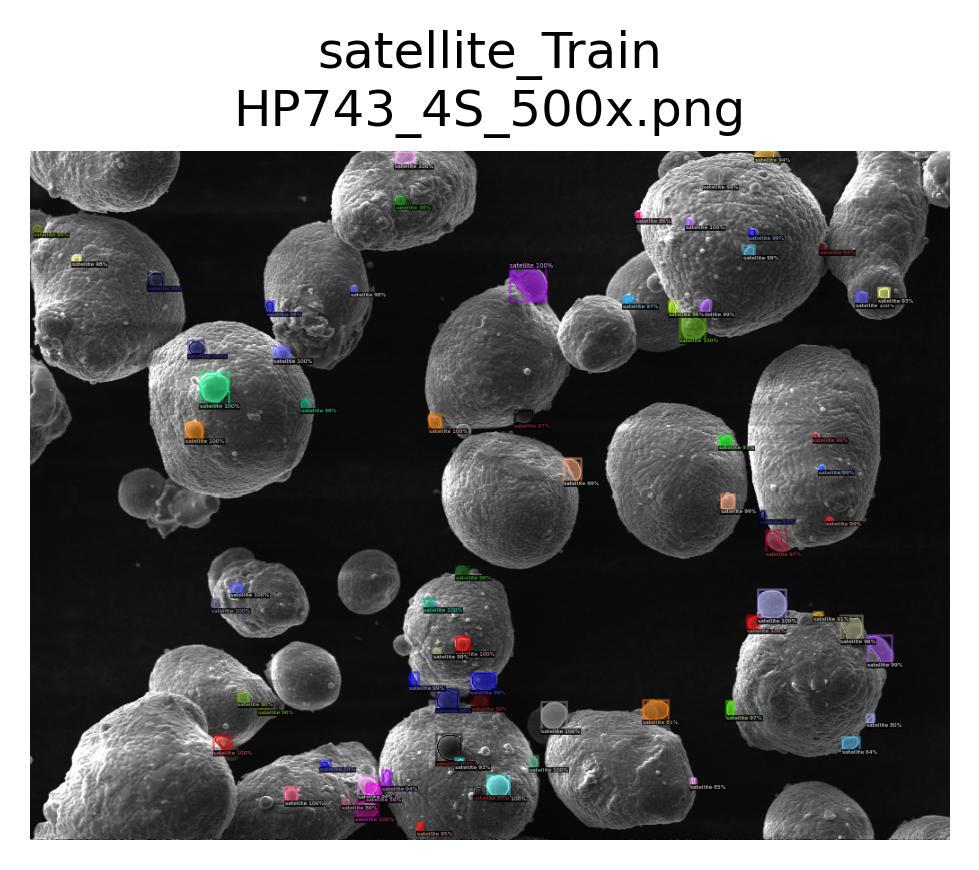

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_4S_500x.png
	num_instances: 73
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_2S_500x.png


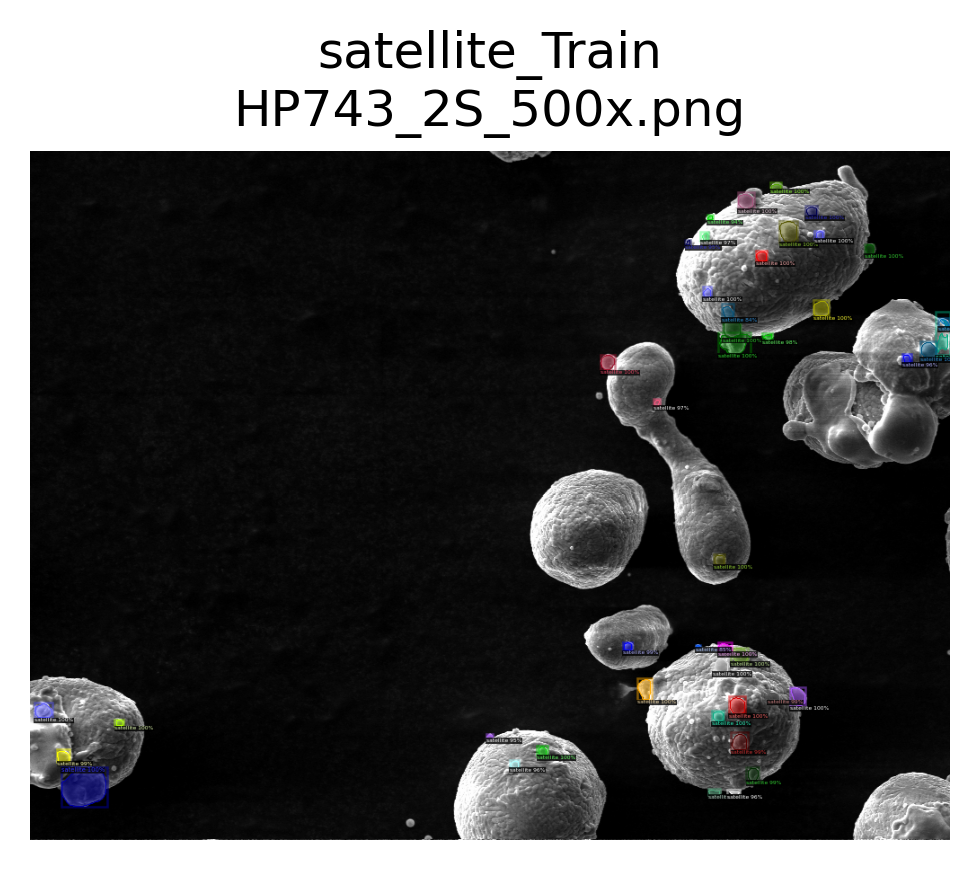

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_2S_500x.png
	num_instances: 44
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_11S_500x.png


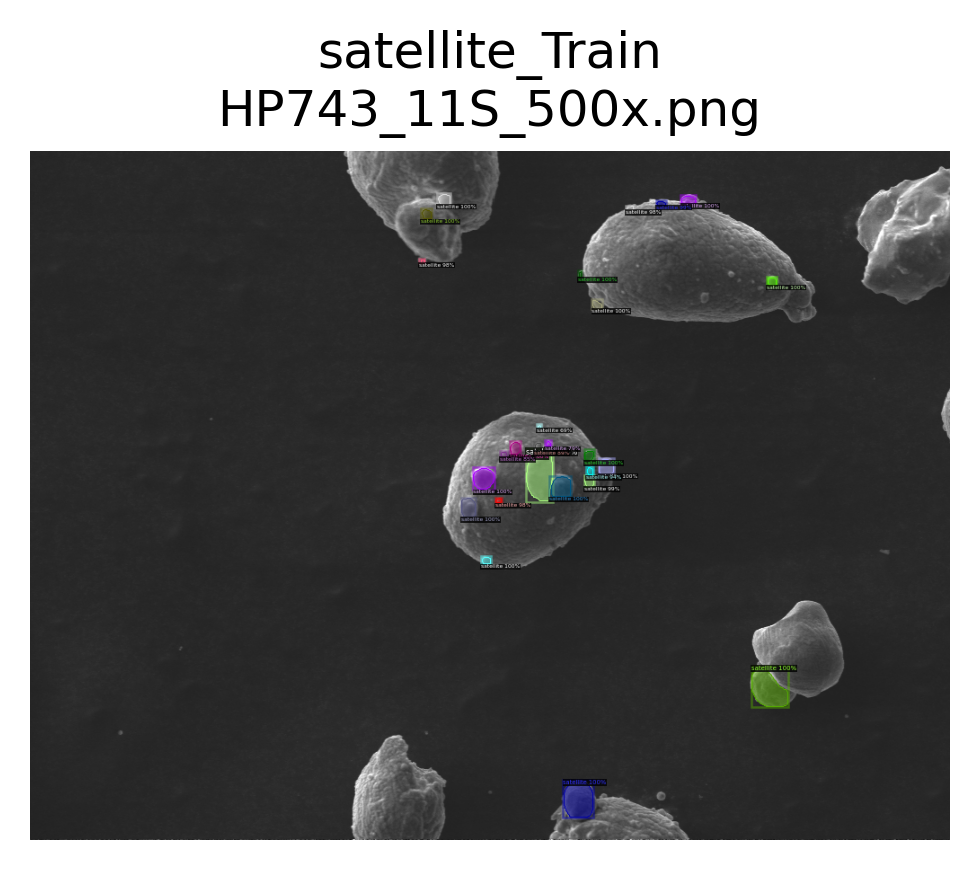

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_11S_500x.png
	num_instances: 26
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_10S_500x.png


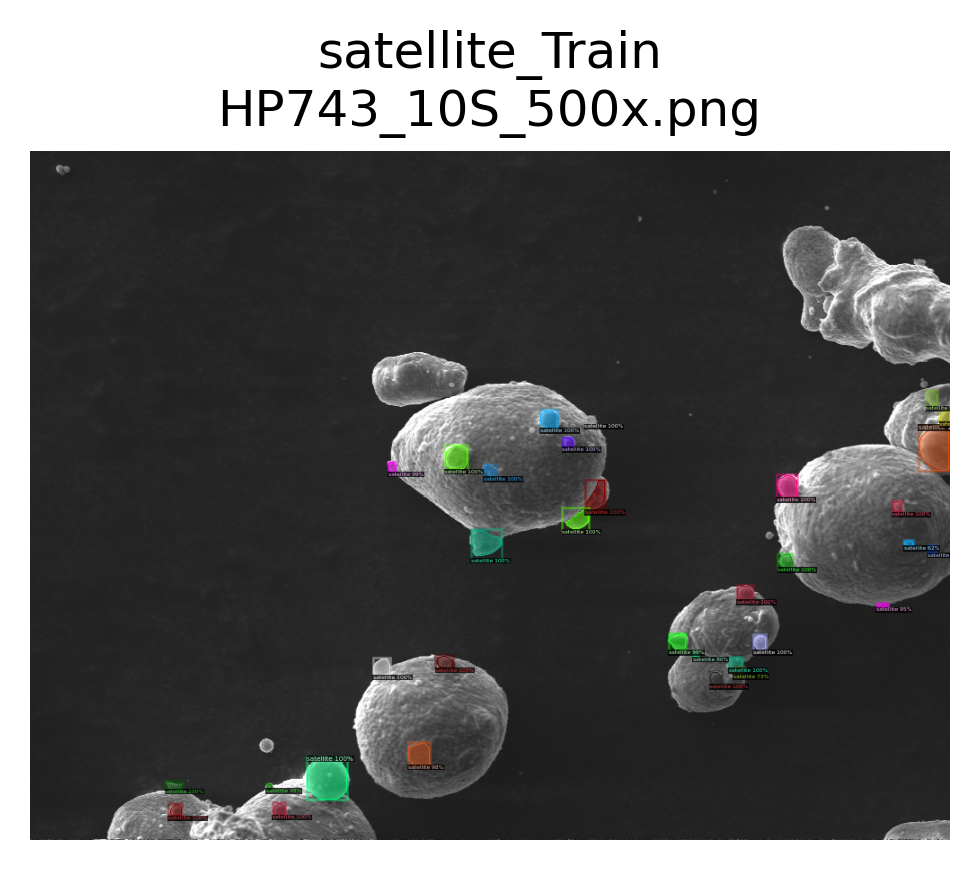

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_10S_500x.png
	num_instances: 33
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_12S_500x.png


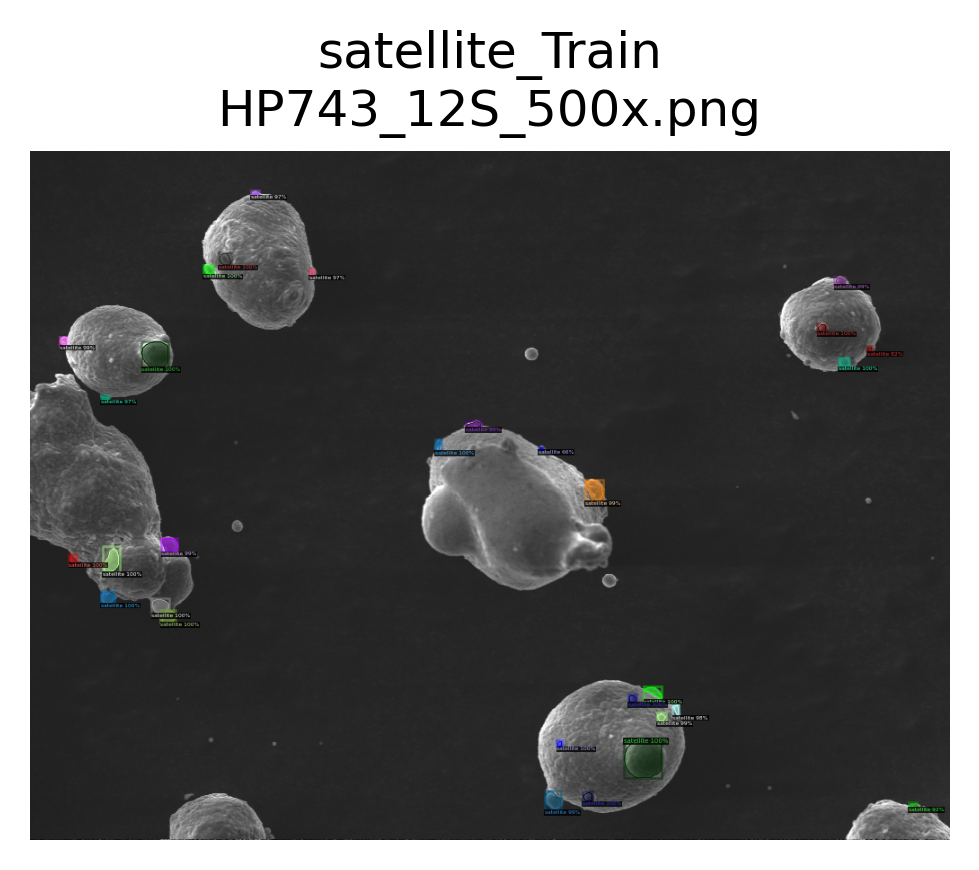

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_12S_500x.png
	num_instances: 30
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_3S_500x.png


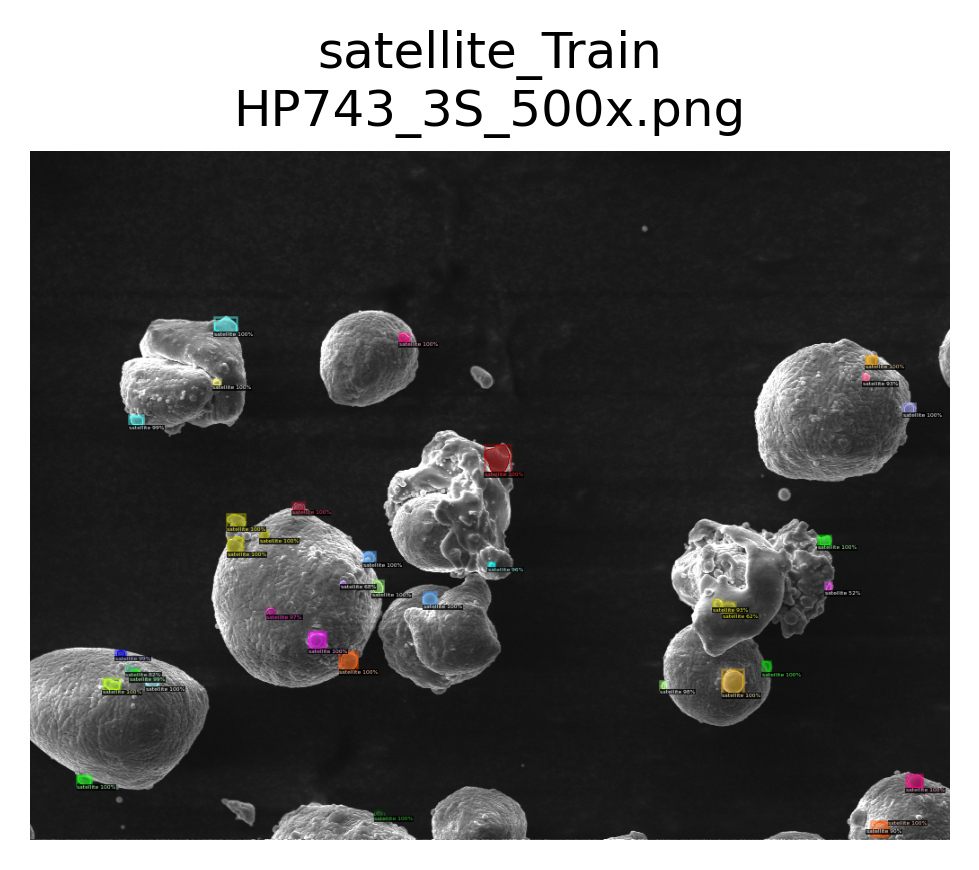

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_3S_500x.png
	num_instances: 37
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_1S_500x.png


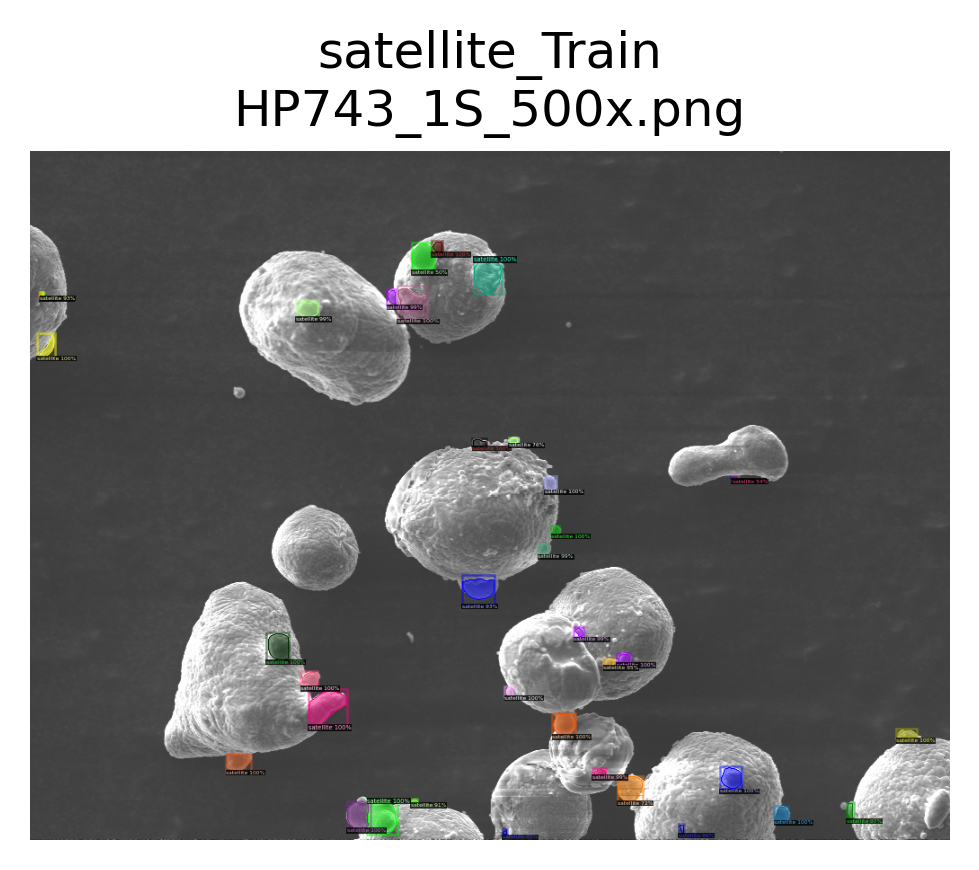

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_1S_500x.png
	num_instances: 37
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_5S_500x.png


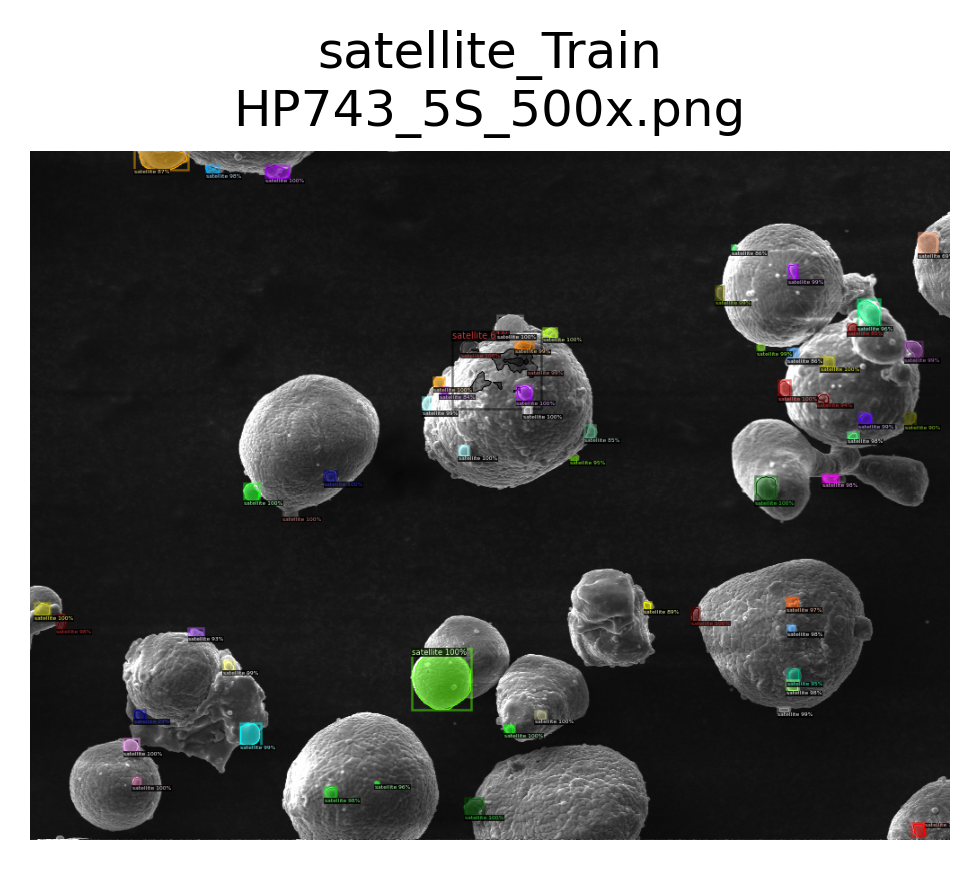

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_5S_500x.png
	num_instances: 59
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S03_02_SE1_1250X35.png


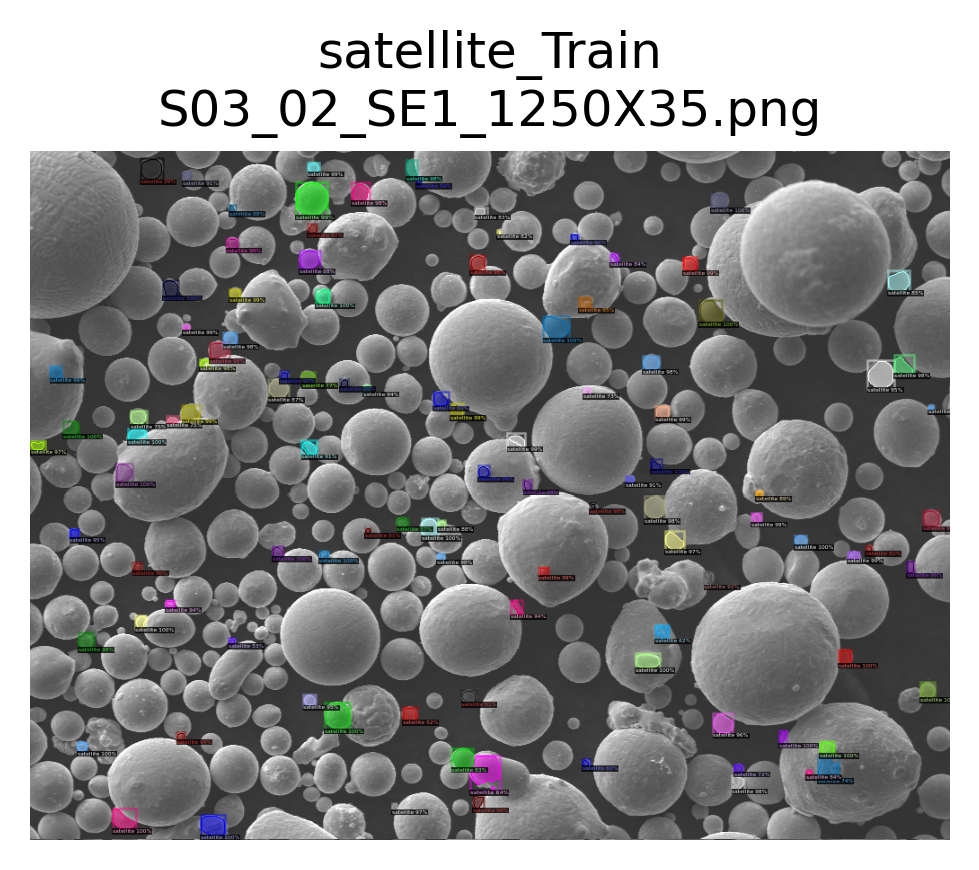

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S03_02_SE1_1250X35.png
	num_instances: 106
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S03_01_SE1_1250X28.png


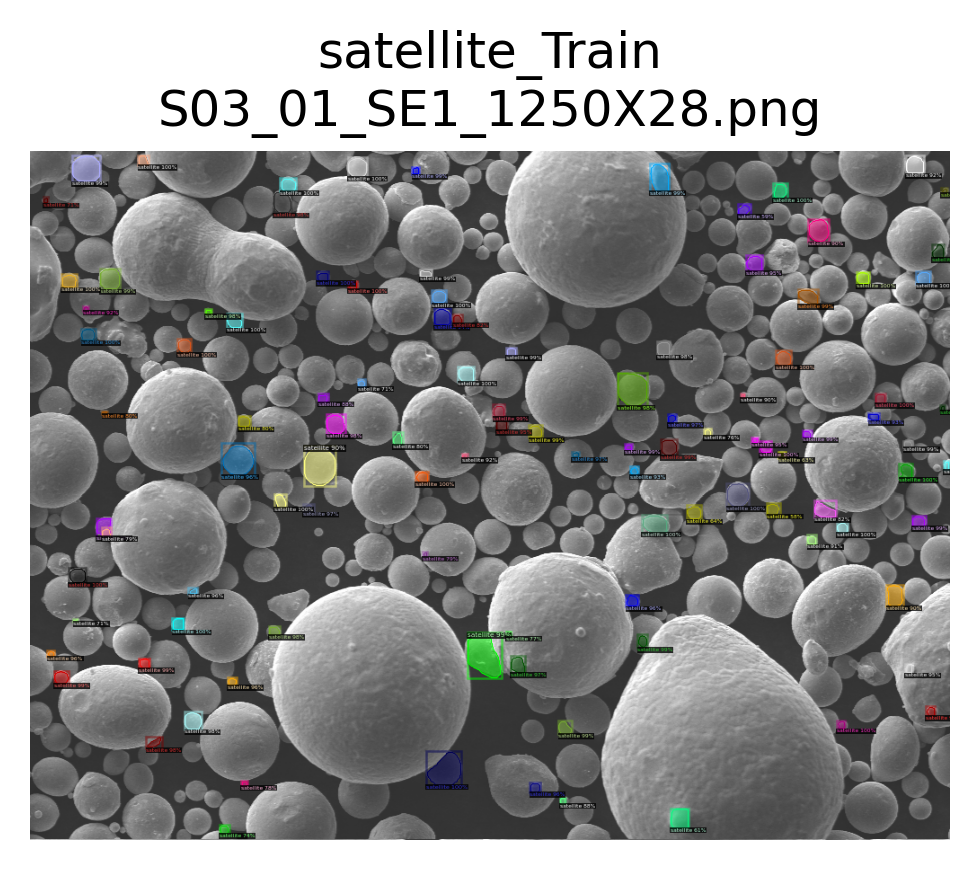

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S03_01_SE1_1250X28.png
	num_instances: 106
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S06_02_SE1_500X71.png


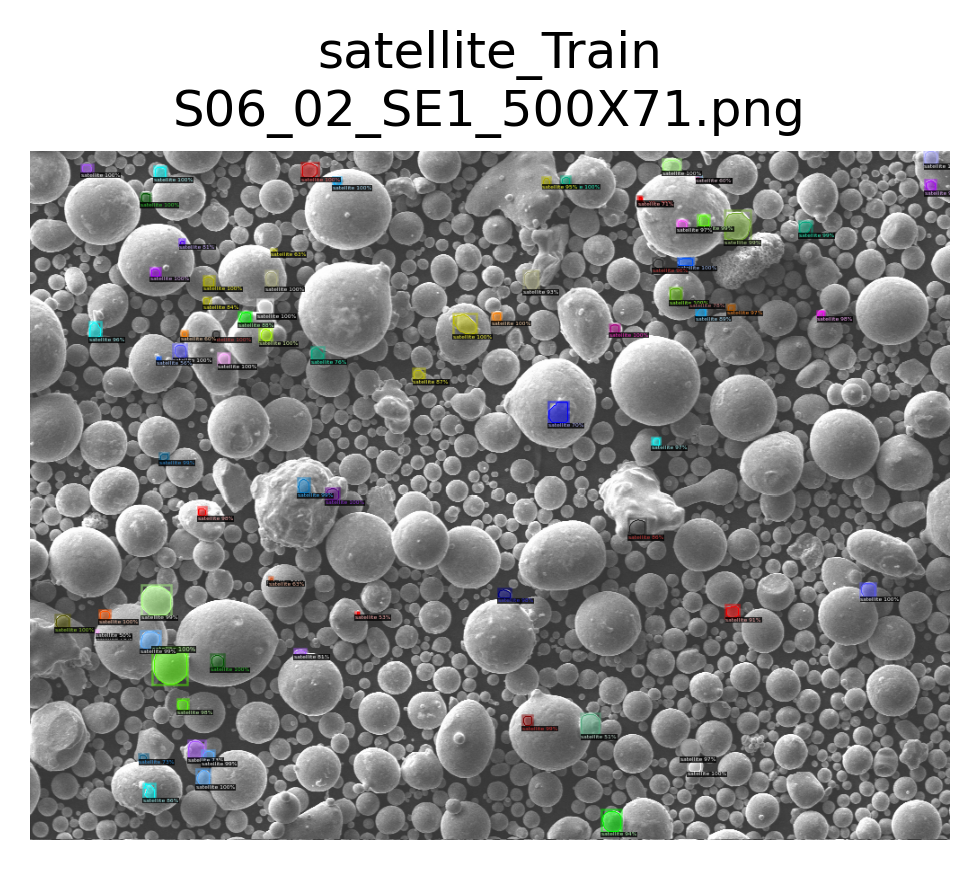

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S06_02_SE1_500X71.png
	num_instances: 79
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S06_03_SE1_500X75.png


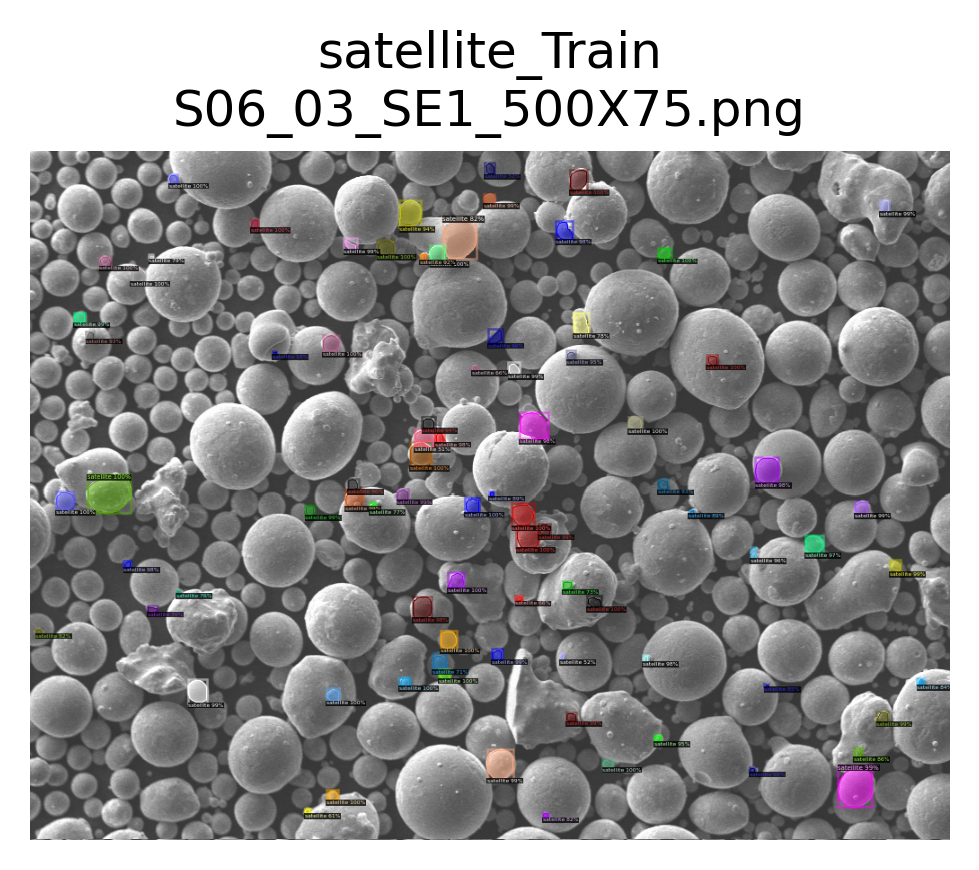

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S06_03_SE1_500X75.png
	num_instances: 83
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S02_02_SE1_300X18.png


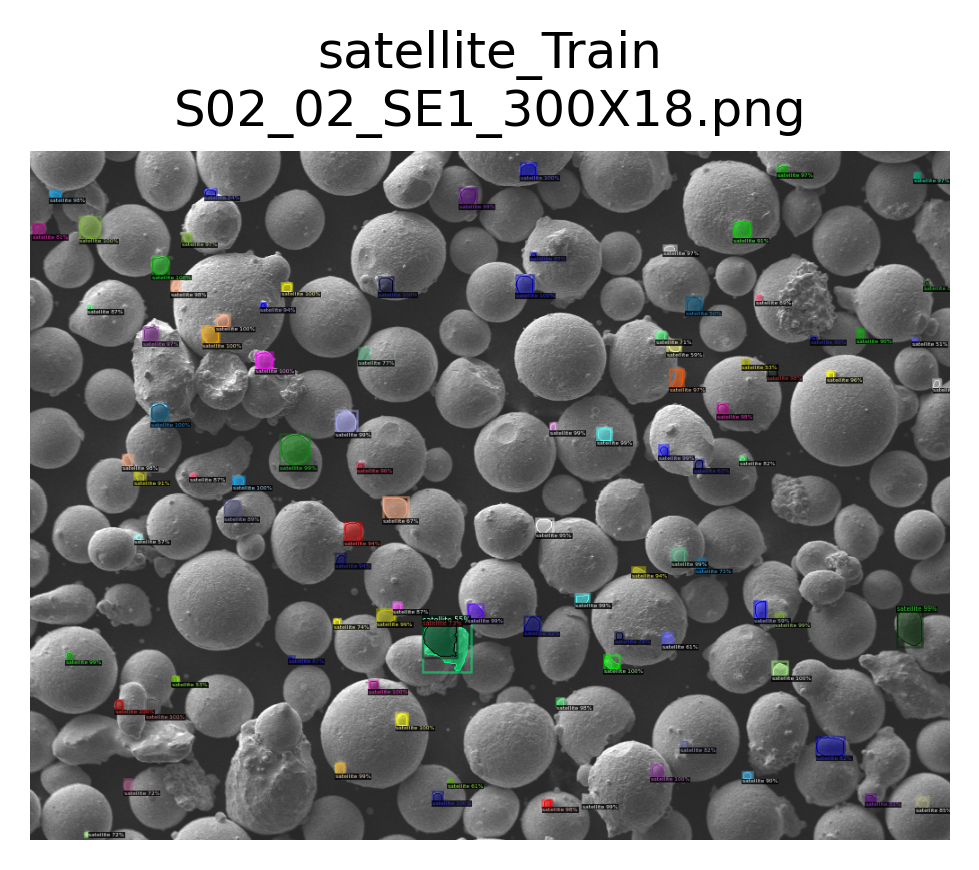

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S02_02_SE1_300X18.png
	num_instances: 97
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S02_03_SE1_300X22.png


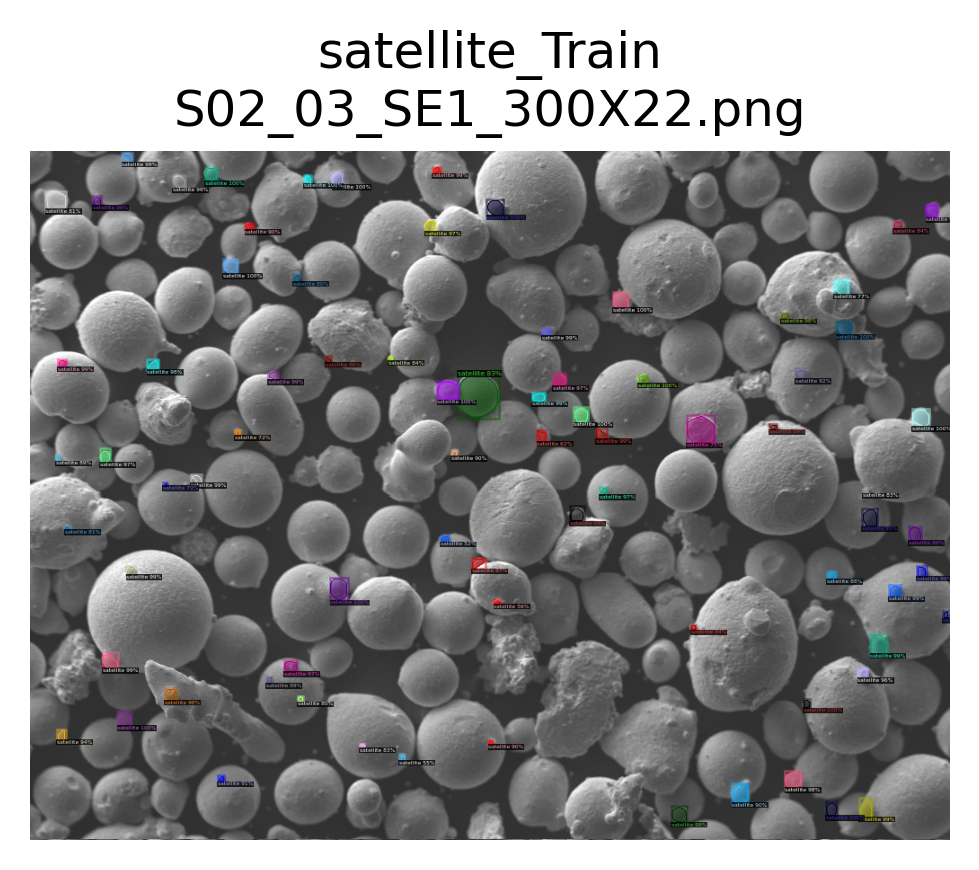

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S02_03_SE1_300X22.png
	num_instances: 78
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_11S_250x.png


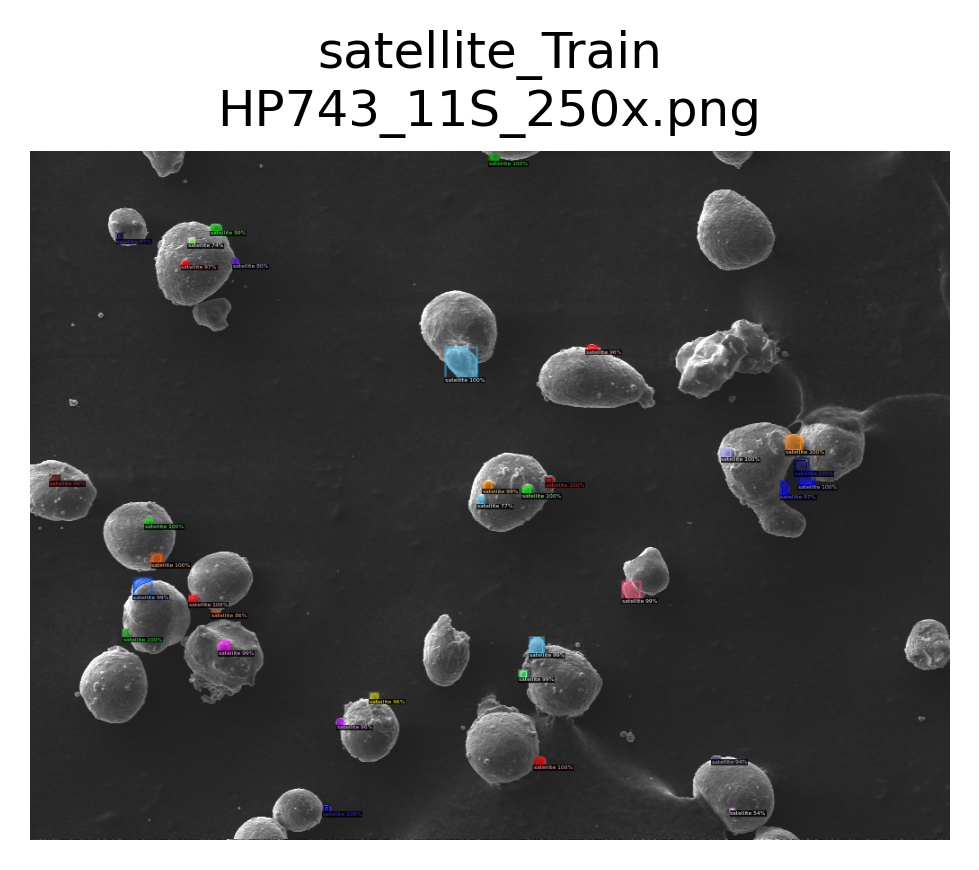

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_11S_250x.png
	num_instances: 34
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_6S_250x.png


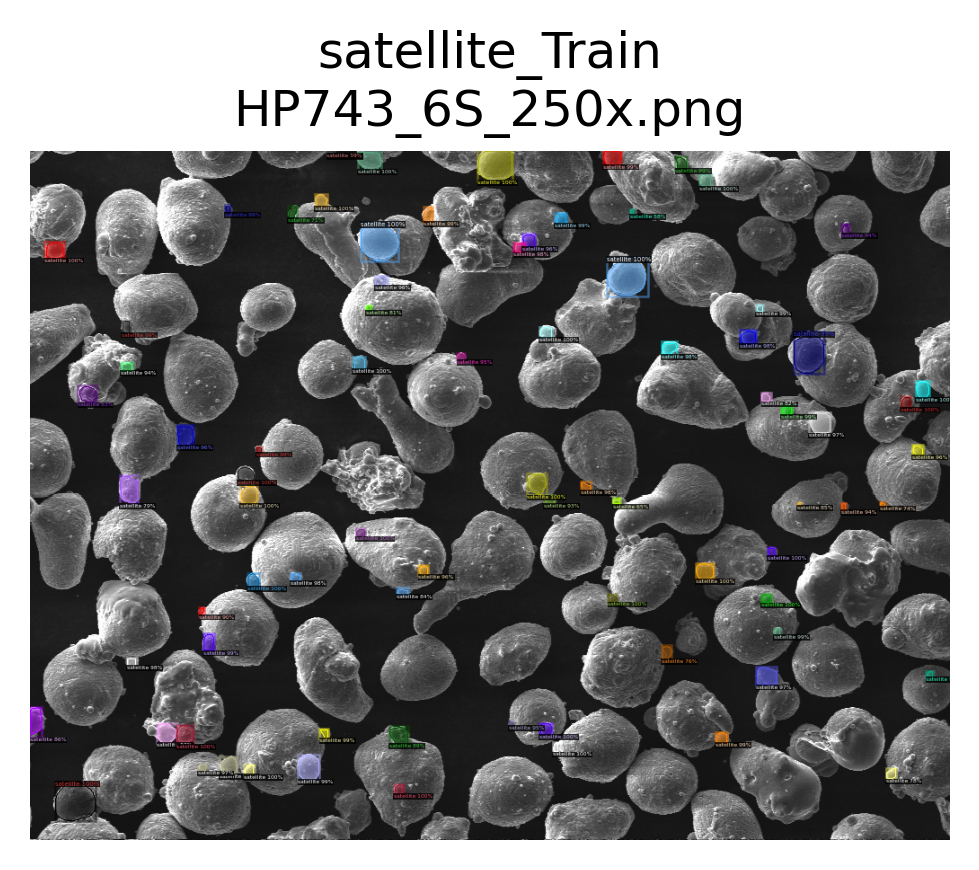

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_6S_250x.png
	num_instances: 81
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S08_02_SE1_1000X99.png


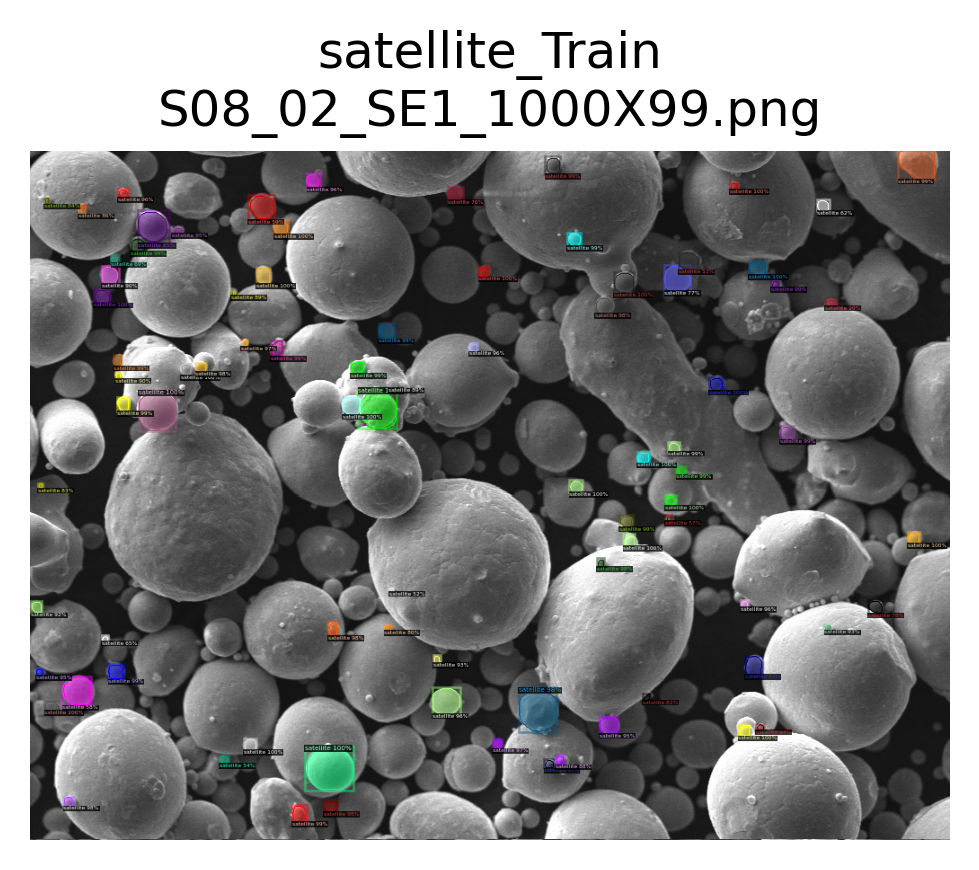

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S08_02_SE1_1000X99.png
	num_instances: 84
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S08_01_SE1_1000X94.png


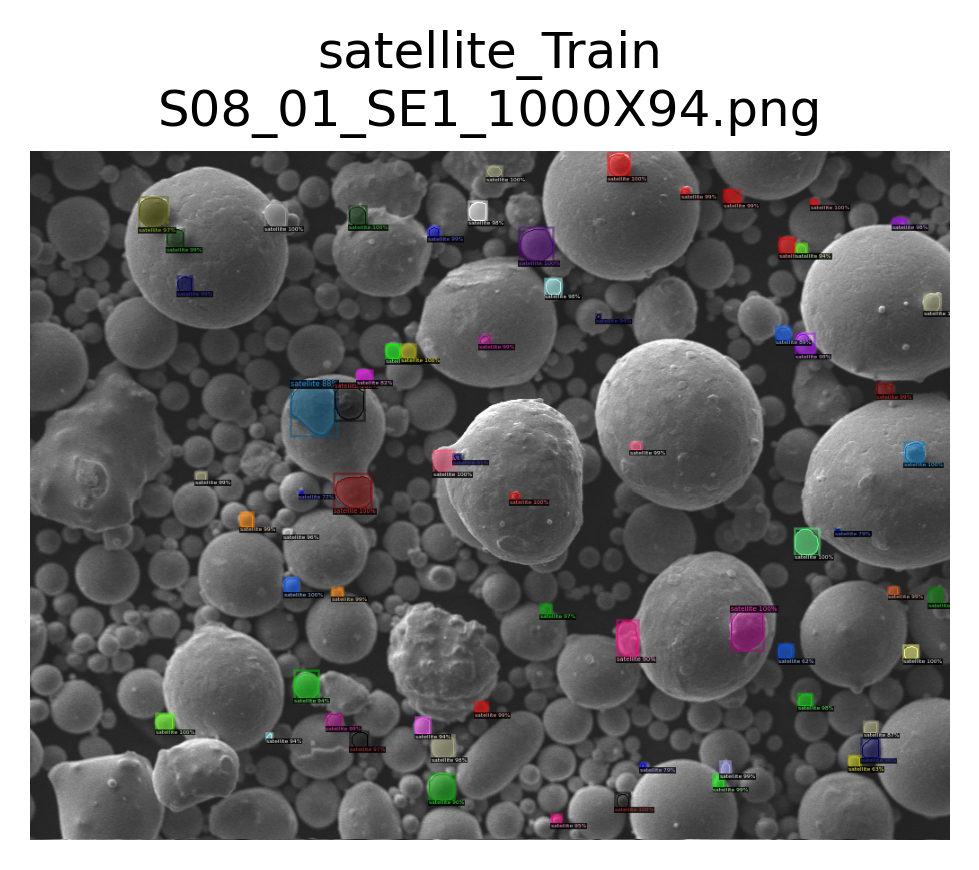

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S08_01_SE1_1000X94.png
	num_instances: 68
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S04_01_SE1_1000X45.png


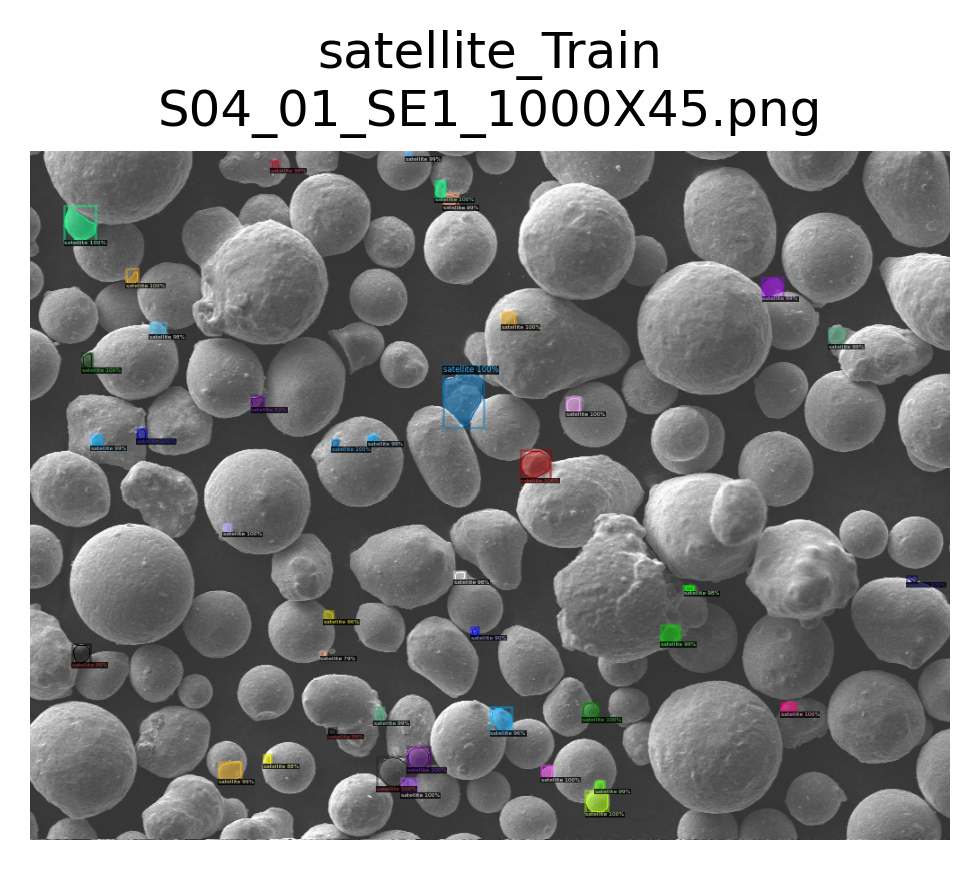

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S04_01_SE1_1000X45.png
	num_instances: 41
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S04_03_SE1_1000X53.png


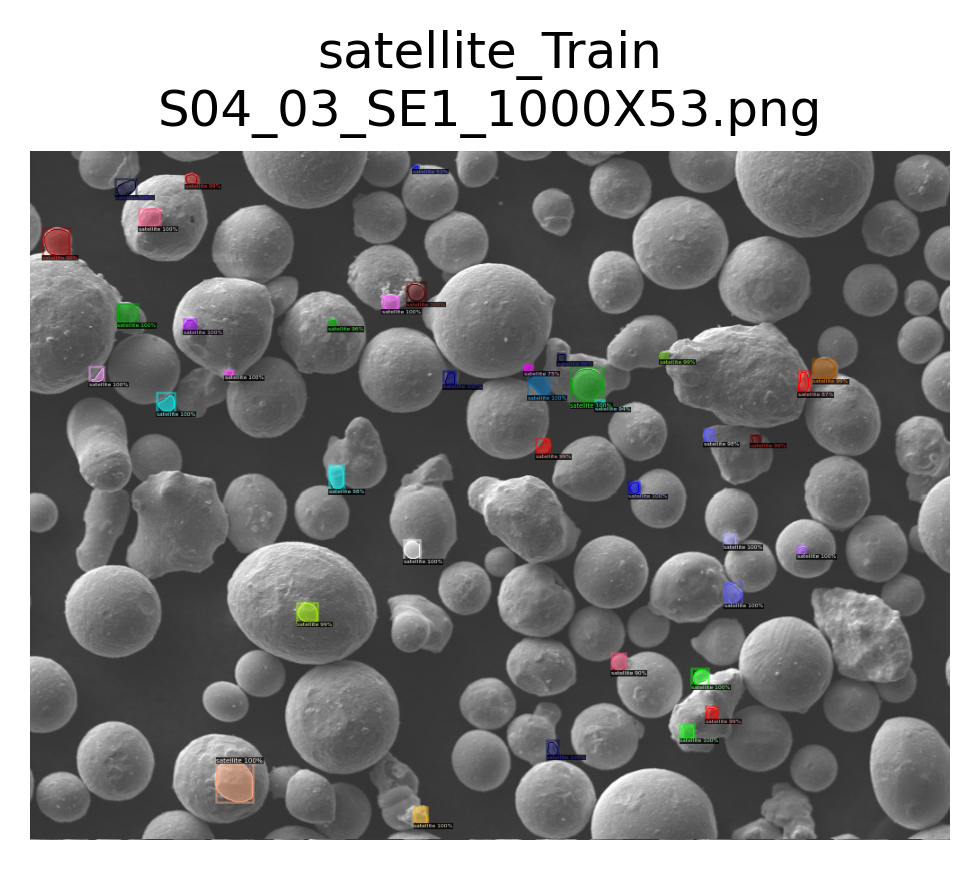

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S04_03_SE1_1000X53.png
	num_instances: 39
Dataset: satellite_Val
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S08_03_SE1_1000X03.png


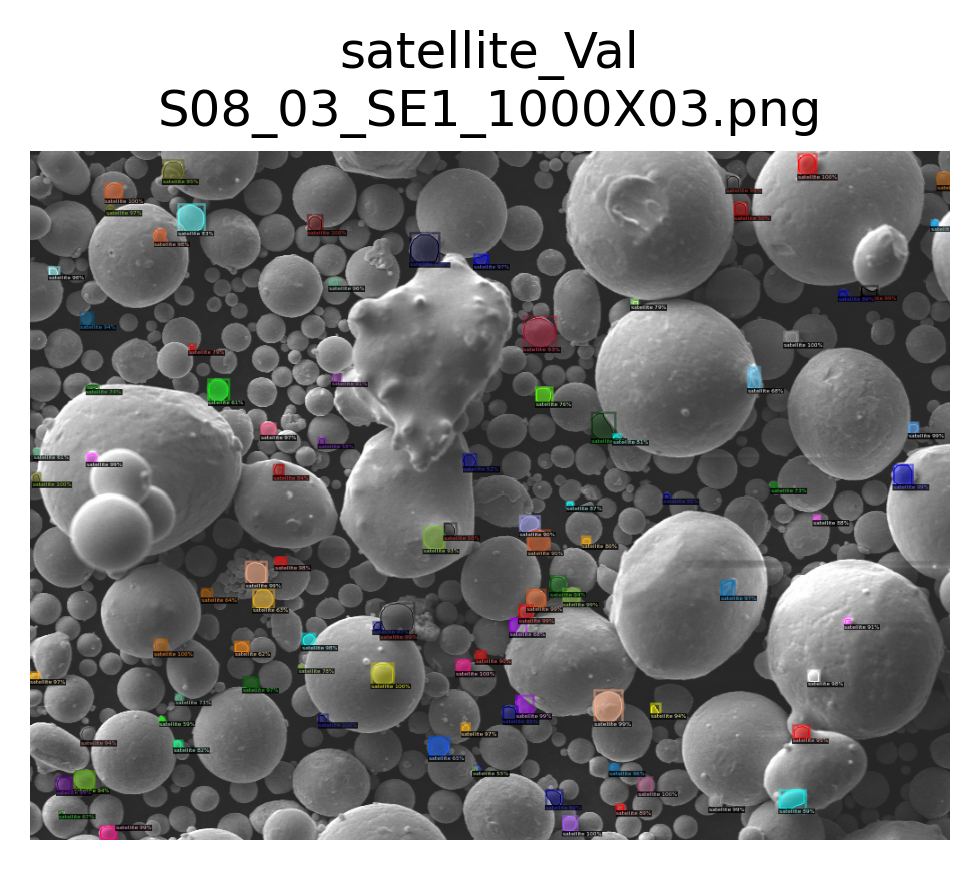

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S08_03_SE1_1000X03.png
	num_instances: 95
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S06_01_SE1_500X67.png


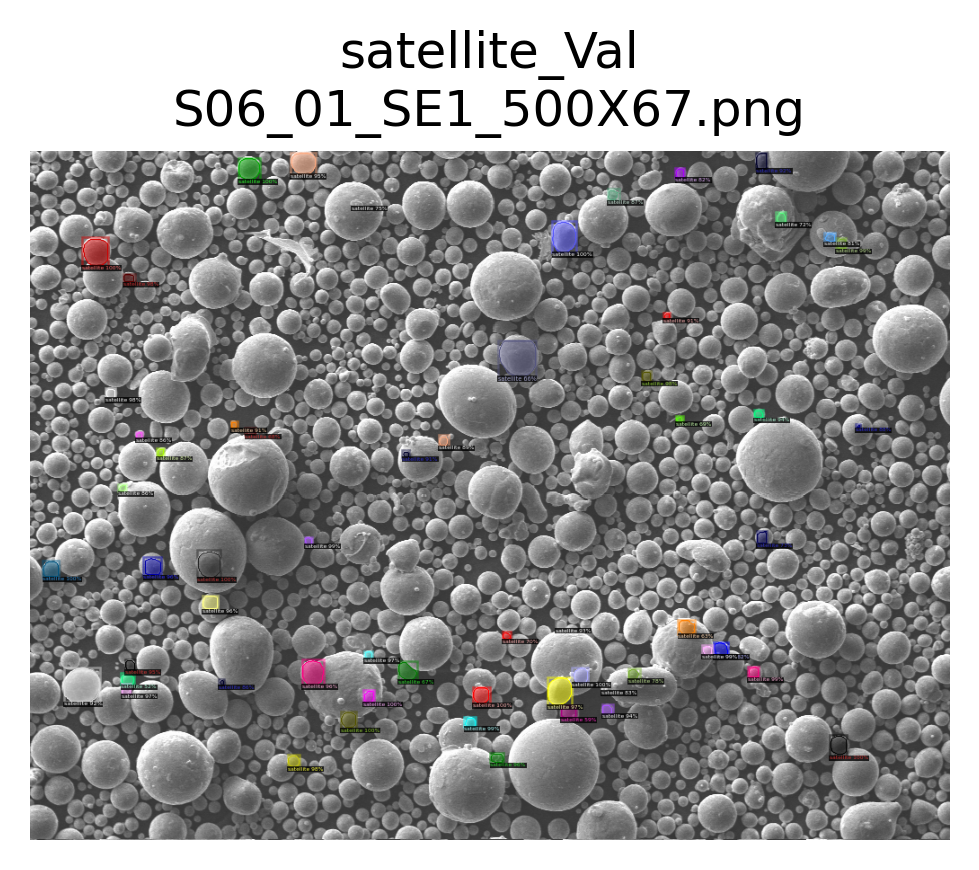

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S06_01_SE1_500X67.png
	num_instances: 59
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S04_02_SE1_1000X50.png


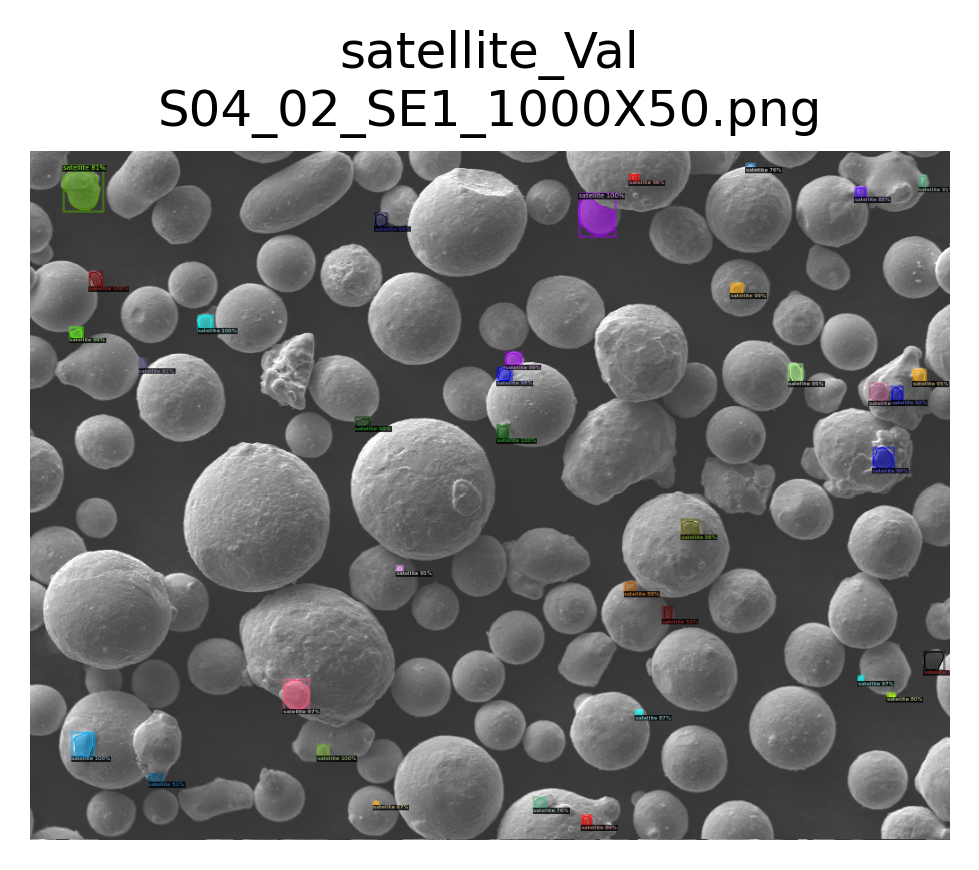

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S04_02_SE1_1000X50.png
	num_instances: 36
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S03_03_SE1_1250X41.png


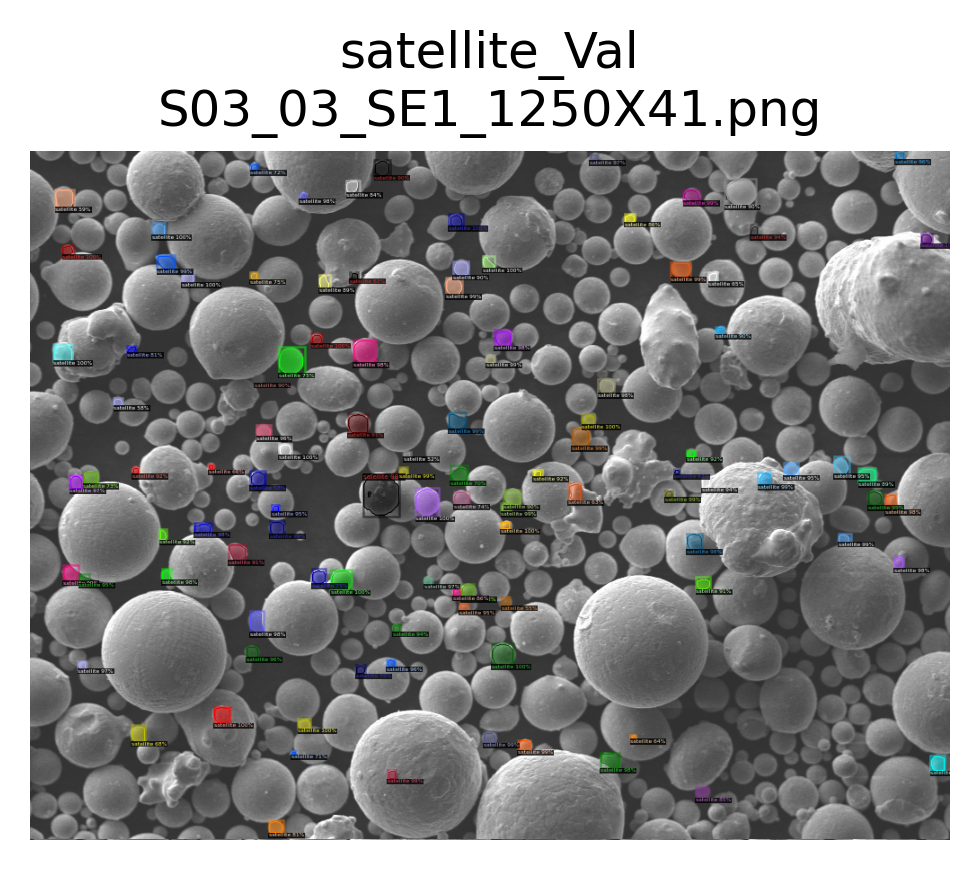

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S03_03_SE1_1250X41.png
	num_instances: 106
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S02_01_SE1_300X14.png


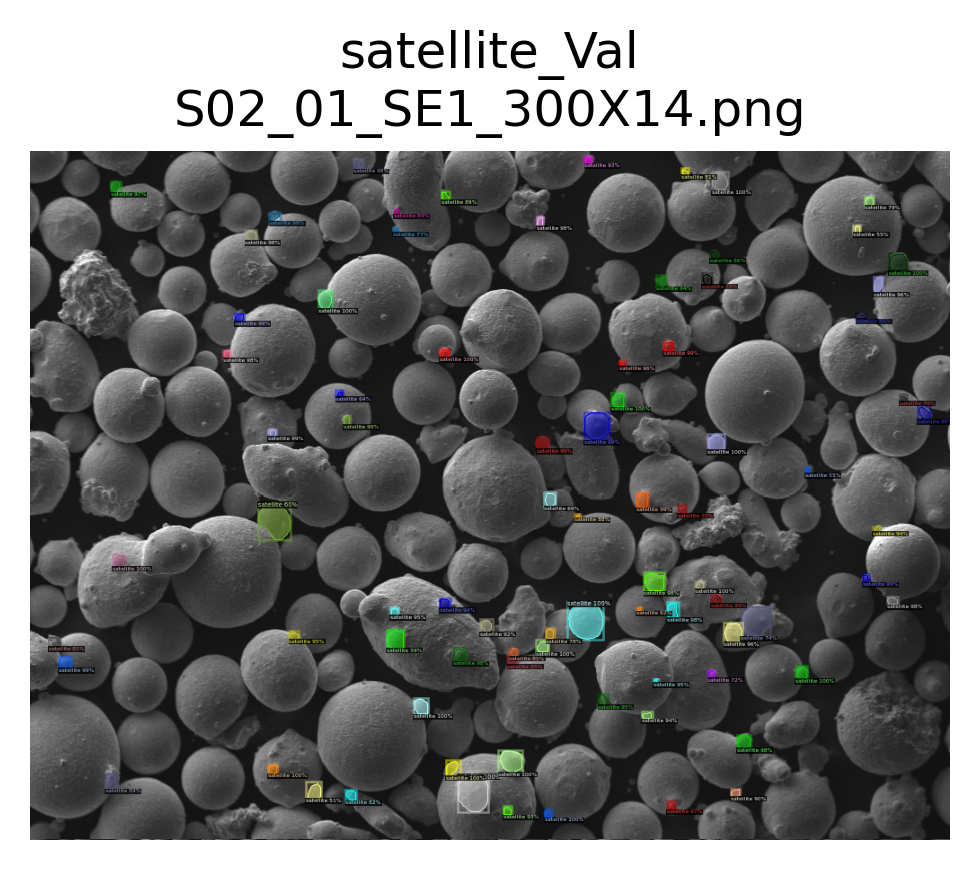

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S02_01_SE1_300X14.png
	num_instances: 82
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_2S_250x.png


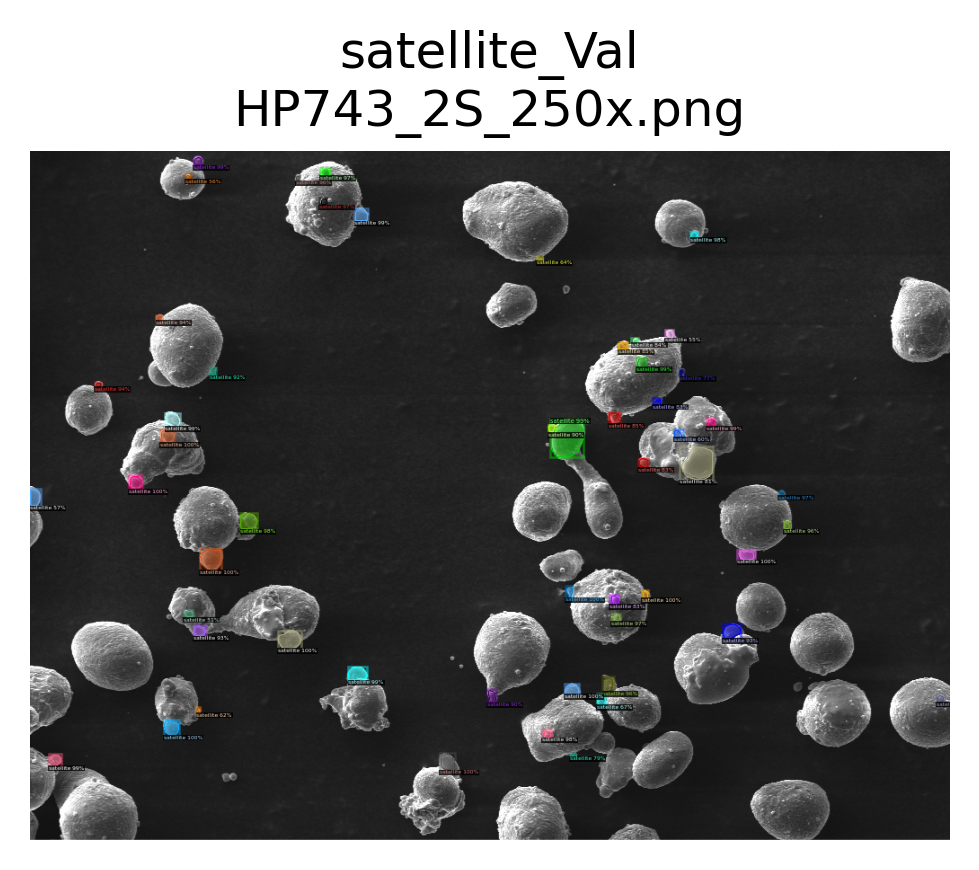

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_2S_250x.png
	num_instances: 53


In [15]:

results = []
for ds in cfg.DATASETS.TEST:
    print(f'Dataset: {ds}')
    for dd in DatasetCatalog.get(ds):
        print(f'\tFile: {dd["file_name"]}')
        img = cv2.imread(dd['file_name'])  # load image
        outs = predictor(img)  # run inference on image
        
        # format results for visualization and store for later
        results.append(data_utils.format_outputs(dd['file_name'], ds, outs))

        # visualize results
        visualize.display_ddicts(outs, None, ds, gt=False, img_path=dd['file_name'])

# save to disk
#with open(Path('Stage_results',f'{EXPERIMENT_NAME}-base_stage.pickle'), 'wb') as f:
#    pickle.dump(results, f)

## Generating predictions on new images is simple.
We will load a new image (not included in either dataset) and generate predictions.
Note that we do not have labels for this image and do not need to register it to a dataset.

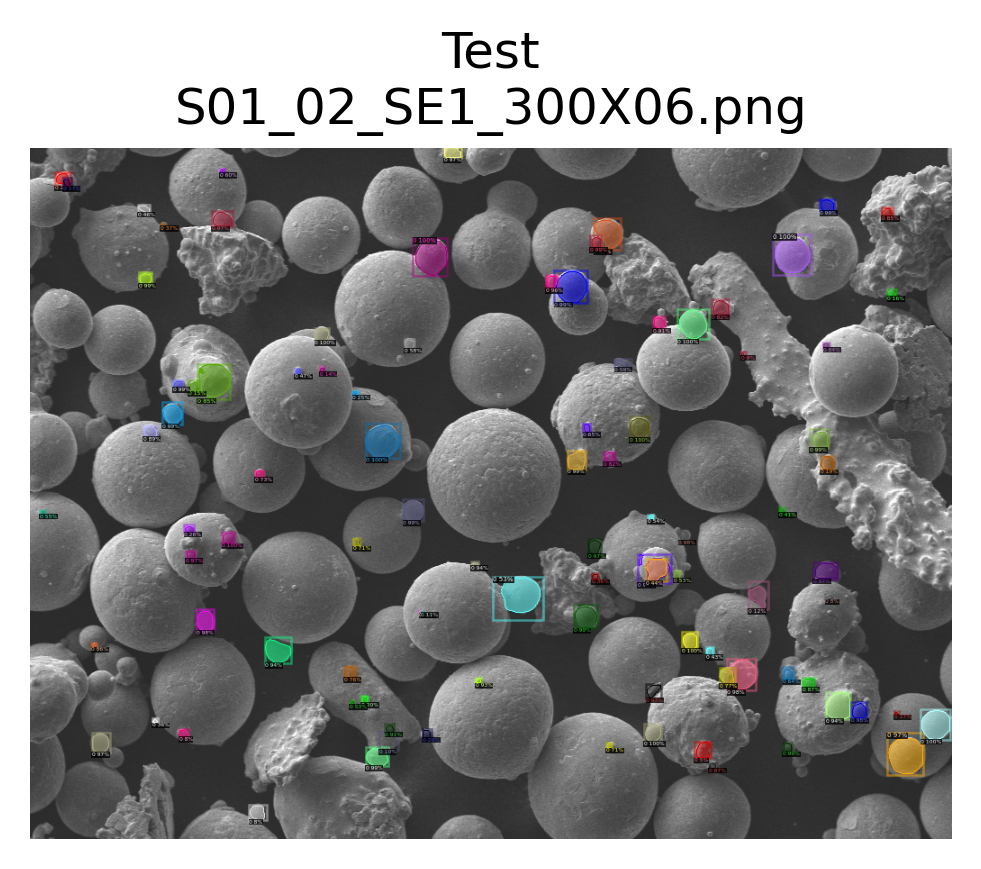

ddict info:
	path: ../data/SEM/S01_02_SE1_300X06.png
	num_instances: 95


In [11]:
img_path = Path('..', 'data','SEM', 'S01_02_SE1_300X06.png')
img = cv2.imread(str(img_path))
outs = predictor(img)
data_utils.format_outputs(img_path, dataset='test', pred=outs)
visualize.display_ddicts(ddict=outs,  # predictions to display
                                 outpath=None, dataset='Test',  # don't save figure
                                 gt=False,  # specifies format as model predictions
                                img_path=img_path)  # path to image
